# Executive Summary

## Approach

1. First, we will conduct EDA to get a feel for *labeled* predictors, to understand what kind of transformations if any are necessary, to determine features irrelevant to pump-failure classification, etc.  One important note: **since our ultimate goal is to build a classification model, we know ahead of time that we will probably be using a model based on Decision Trees... probably gradient-boosted Decision Trees - e.g. `RandomForestClassifier` or `XGBClassifier`; so we will conduct data transformations accordingly - for example, in the case of high-cardinality categorical variables, gradient-boosted decision tree classifiers generally do not work well when such categorical variables are One-Hot Encoded**
2. As we go, we will create data "transmformation" rules output from the above insights; these rules will be used by `Tranformer` objects which will then be added to an sklean `Pipeline`.
3. These rules will first be applied to all *labeled* predictors/data.
4. We will then split *labeled* data into *training* and *validation* partitions.
5. We will build classification models on the *training* partition and then use the *validation* partition for model scoring and evaluation (since we have corresponding labels).
6. We will select the best model based on the above to then apply the `Pipeline`d transformations to the *unlabeled* predictors/data, in order to produce our final set of labels predicted from the *unlabeled* data, for submission to the competition repository.

# Import Libraries

In [1]:
import scjpnlib.utils as scjpnutils
import pandas as pd
import numpy as np
from scjpnlib.utils.file_io import FileManager
from IPython.core.display import HTML, Markdown
import matplotlib.pyplot as plt

from sklearn.pipeline import Pipeline
from scjpnlib.utils.skl_transformers import DropColumnsTransformer, LambdaTransformer, SimpleValueTransformer, OneHotEncodingTransformer, LabelEncodingTransformer, TargetEncoderLOOTransformer
from sklearn.preprocessing import FunctionTransformer

from scjpnlib.utils import submodels as scjpnsubmodels

# alternate methods to consider...
from string_grouper import StringGrouper
from category_encoders import *

from sklearn.model_selection import train_test_split


%load_ext autoreload
%autoreload 2

# Load/Read Config

The following reads properties from the `eda-config.txt` file as JSON.  (see the `eda-config.txt` file for documentation on config parameters)

In [2]:
fm = FileManager()
eda_config = fm.load_json('eda-config.txt')
eda_config

{'official_data': {'unlabeled_predictors': {'url': 'https://s3.amazonaws.com/drivendata-prod/data/7/public/702ddfc5-68cd-4d1d-a0de-f5f566f76d91.csv',
   'local_fname': 'Taarifa-Unlabeled-Predictors.csv'},
  'labeled_predictors': {'url': 'https://s3.amazonaws.com/drivendata-prod/data/7/public/4910797b-ee55-40a7-8668-10efd5c1b960.csv',
   'local_fname': 'Taarifa-Labeled-Predictors.csv'},
  'labels': {'url': 'https://s3.amazonaws.com/drivendata-prod/data/7/public/0bf8bc6e-30d0-4c50-956a-603fc693d966.csv',
   'local_fname': 'Taarifa-Labels.csv'}},
 'eda_desc': {'short': '0.10 test_ratio, flat insig cat hat handling with threshold 10; location based on ward'},
 'test_ratio': 0.1,
 'SEED': 42,
 'insig_cat_handling': {'installer': {'strategy': 'flat',
   'threshold': 10,
   'map_to': 'other'},
  'scheme_name': {'strategy': 'flat', 'threshold': 10, 'map_to': 'other'},
  'ward': {'strategy': 'flat', 'threshold': 10, 'map_to': 'other'}},
 'override_drop_feats': [],
 'wrangled_data': {'fname_ext'

In [3]:
display(HTML(f"<b>NOTE: <i>for the above experiement configuration, wrangled and partitioned label output files will be identified (filename suffix) by: hash digest: {scjpnutils.json_to_md5_hash_digest(eda_config)}</i></b>"))

# Obtain the Data: Labels, Labeled Predictors, and Unlabeled Predictors

In [4]:
fname_unlabeled_predictors = eda_config['official_data']['unlabeled_predictors']['local_fname']
fname_labeled_predictors = eda_config['official_data']['labeled_predictors']['local_fname']
fname_labels = eda_config['official_data']['labels']['local_fname']

ds_map = {
    fname_unlabeled_predictors: eda_config['official_data']['unlabeled_predictors']['url'], 
    fname_labeled_predictors: eda_config['official_data']['unlabeled_predictors']['url'],
    fname_labels: eda_config['official_data']['unlabeled_predictors']['url']
}

fm.validate_download(ds_map)

# Explore the Data

Before we get into our analysis, let's initialize some objects/variables that will be used throughout.

One thing to note: in keeping with the Approach outline above, we will be building the preprocessing `Pipeline` as we go.  

So let's take care of these initialization details now.

In [5]:
SEED = eda_config['SEED'] # for random_state reproducability

pipeline_data_preprocessor = Pipeline(steps=[('passthrough', None)])

In [6]:
labeled_with_target = pd.concat(
    [
        pd.read_csv(fname_labeled_predictors, index_col=0), 
        pd.read_csv(fname_labels, index_col=0)
    ], 
    axis=1
    ,
    join='inner'
).sort_index()

labeled_with_target

,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,...,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group,status_group
id,,,,,,,,,,,,,,,,,,,,,
0,0.0,2012-11-13,Tasaf,0,TASAF,33.125828,-5.118154,Mratibu,0,Lake Tanganyika,...,milky,milky,enough,enough,shallow well,shallow well,groundwater,hand pump,hand pump,non functional
1,0.0,2011-03-05,Shipo,1978,SHIPO,34.770717,-9.395642,none,0,Rufiji,...,soft,good,enough,enough,shallow well,shallow well,groundwater,hand pump,hand pump,functional
2,0.0,2011-03-27,Lvia,0,LVIA,36.115056,-6.279268,Bombani,0,Wami / Ruvu,...,soft,good,insufficient,insufficient,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe,functional
3,10.0,2013-06-03,Germany Republi,1639,CES,37.147432,-3.187555,Area 7 Namba 5,0,Pangani,...,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe,functional
4,0.0,2011-03-22,Cmsr,0,CMSR,36.164893,-6.099289,Ezeleda,0,Wami / Ruvu,...,soft,good,dry,dry,shallow well,shallow well,groundwater,hand pump,hand pump,non functional
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
74240,0.0,2013-03-22,World Vision,1183,World vision,37.007726,-3.280868,Upendo Primary School,0,Pangani,...,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe,functional
74242,0.0,2011-04-12,Danida,0,DANIDA,33.724987,-8.940758,Kwa Mvulula,0,Rufiji,...,soft,good,enough,enough,river,river/lake,surface,communal standpipe,communal standpipe,functional
74243,0.0,2012-11-13,Ministry Of Water,1188,Hesawa,33.963539,-1.429477,Kwa Wambura Msege,0,Lake Victoria,...,soft,good,enough,enough,lake,river/lake,surface,communal standpipe multiple,communal standpipe,non functional


## Labels

In [7]:
labels = labeled_with_target[['status_group']]
labels.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 59400 entries, 0 to 74247
Data columns (total 1 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   status_group  59400 non-null  object
dtypes: object(1)
memory usage: 928.1+ KB


In [8]:
labels.status_group.value_counts()

functional                 32259
non functional             22824
functional needs repair     4317
Name: status_group, dtype: int64

In [9]:
labels.status_group.value_counts(normalize=True)

functional                 0.543081
non functional             0.384242
functional needs repair    0.072677
Name: status_group, dtype: float64

In [10]:
let_labels = LabelEncodingTransformer(['status_group'])
labels_encoded = let_labels.fit_transform(labels)
labels_encoded.status_group.unique()

array([2, 0, 1])

In [11]:
classes = list(let_labels.labelencoder.classes_)
classes

['functional', 'functional needs repair', 'non functional']

In [12]:
labels_encoded.status_group.value_counts()

0    32259
2    22824
1     4317
Name: status_group, dtype: int64

In [13]:
labels_encoded.status_group.value_counts(normalize=True)

0    0.543081
2    0.384242
1    0.072677
Name: status_group, dtype: float64

In [14]:
labeled_with_target['status_group_encoded'] = labels_encoded.status_group

## Predictors

In [15]:
X_unlabeled = pd.read_csv(fname_unlabeled_predictors, index_col=0).sort_index()

X_labeled = labeled_with_target.drop(['status_group', 'status_group_encoded'], axis=1)

So, since we have 59400 rows after the join, all rows of predictors match up to a label, based on <b>id</b>.

### Labeled (Predictors)

Here, before we get into more detailed analysis, let's consider the descriptions (retrieved from https://www.drivendata.org/competitions/7/pump-it-up-data-mining-the-water-table/page/25/#features_list) of the predictors/features:


- **amount_tsh** - Total static head (amount water available to waterpoint)
- **date_recorded** - The date the row was entered
- **funder** - Who funded the well
- **gps_height** - Altitude of the well
- **installer** - Organization that installed the well
- **longitude** - GPS coordinate
- **latitude** - GPS coordinate
- **wpt_name** - Name of the waterpoint if there is one
- **num_private** -
- **basin** - Geographic water basin
- **subvillage** - Geographic location
- **region** - Geographic location
- **region_code** - Geographic location (coded)
- **district_code** - Geographic location (coded)
- **lga** - Geographic location
- **ward** - Geographic location
- **population** - Population around the well
- **public_meeting** - True/False
- **recorded_by** - Group entering this row of data
- **scheme_management** - Who operates the waterpoint
- **scheme_name** - Who operates the waterpoint
- **permit** - If the waterpoint is permitted
- **construction_year** - Year the waterpoint was constructed
- **extraction_type** - The kind of extraction the waterpoint uses
- **extraction_type_group** - The kind of extraction the waterpoint uses
- **extraction_type_class** - The kind of extraction the waterpoint uses
- **management** - How the waterpoint is managed
- **management_group** - How the waterpoint is managed
- **payment** - What the water costs
- **payment_type** - What the water costs
- **water_quality** - The quality of the water
- **quality_group** - The quality of the water
- **quantity** - The quantity of water
- **quantity_group** - The quantity of water
- **source** - The source of the water
- **source_type** - The source of the water
- **source_class** - The source of the water
- **waterpoint_type** - The kind of waterpoint
- **waterpoint_type_group** - The kind of waterpoint

Based on the descriptions and names alone, it appears that there is some duplication of data (which is perhaps represented differently).

Let's have a high-level look at the features.

In [16]:
X_labeled_clean = X_labeled.copy()
scjpnutils.analyze_values(X_labeled_clean, 'X_labeled');

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,amount_tsh,float64,98,"[0.0, 10.0, 50.0, 30.0, 250.0, 1000.0, 100.0, ...",0.001650,99.84,0,0.000000,None
1,date_recorded,object,356,"[2012-11-13, 2011-03-05, 2011-03-27, 2013-06-0...",0.005993,99.40,0,0.000000,None
2,funder,object,1898,"[Tasaf, Shipo, Lvia, Germany Republi, Cmsr, Pr...",0.031953,96.80,3635,0.061195,"Int64Index([ 22, 28, 80, 119, 120,..."
3,gps_height,int64,2428,"[0, 1978, 1639, 28, 64, 1332, 1014, 1606, 226,...",0.040875,95.91,0,0.000000,None
4,installer,object,2146,"[TASAF, SHIPO, LVIA, CES, CMSR, Private, Gover...",0.036128,96.39,3655,0.061532,"Int64Index([ 22, 28, 80, 119, 139,..."
5,longitude,float64,57516,"[33.1258283, 34.77071669, 36.11505595, 37.1474...",0.968283,3.17,0,0.000000,None
6,latitude,float64,57517,"[-5.11815407, -9.39564152, -6.27926803, -3.187...",0.968300,3.17,0,0.000000,None
7,wpt_name,object,37400,"[Mratibu, none, Bombani, Area 7 Namba 5, Ezele...",0.629630,37.04,0,0.000000,None
8,num_private,int64,65,"[0, 5, 65, 1, 15, 93, 6, 2, 80, 41, 7, 16, 45,...",0.001094,99.89,0,0.000000,None
9,basin,object,9,"[Lake Tanganyika, Rufiji, Wami / Ruvu, Pangani...",0.000152,99.98,0,0.000000,None


The first things to notice are:

1. Most predictors appear to be objects (strings) and those are likely categorical.
2. Some predictors have null/missing values.

<p><br><br>
Let's examine our predictors in more detail.  There are a number of ways to look at these predictors.

Since, from a high-level, based on their descriptions, various predictors can be grouped together by the kind of content (data) they contain.

For example, we see that features **extraction_type**, **extraction_type_group**, and **extraction_type_class** all have the same description:

   "The kind of extraction the waterpoint uses".

So, our first angle of attack will be to split features into these groups.  What we are doing here is effectively ad-hoc classification of the "meta-data" (kind) of features.

Let's see how it goes.

As a start, it looks like we have the following general "categories" of predictor, based purely on their descriptions:

In [17]:
predictors_kind_classification = {
    'amount_tsh': {
        'description': "'Total static head (amount water available to waterpoint)'",
        'features': ['amount_tsh']
    },

    'pump_age_at_observation_date': {
        'description': "'The date the row was entered' - 'Year the waterpoint was constructed'",
        'features': ['date_recorded', 'construction_year']
    },

    'funder': {
        'description': "'Who funded the well'",
        'features': ['funder']
    },

    'gps_height': {
        'description': "'Altitude of the well'",
        'features': ['gps_height']
    },

    'installer': {
        'description': "'Organization that installed the well'",
        'features': ['installer']
    },

    'gps_coordinates': {
        'description': "('GPS coordinate' (latitude), 'GPS coordinate' (longitude))",
        'features': ['latitude', 'longitude']
    },

    'wpt_name': {
        'description': "'Name of the waterpoint if there is one'",
        'features': ['wpt_name']
    },

    'num_private': {
        'description': "", # no description was provided, so we don't really know what this is based purely on description
        'features': ['num_private']
    },

    'basin': {
        'description': "'Geographic water basin'",
        'features': ['basin']
    },

    'geographic_location_coded': {
        'description': "'Geographic location (coded)'",
        'features': ['region_code', 'district_code']
    },

    'geographic_location': {
        'description': "'Geographic location'",
        'features': ['subvillage', 'region', 'lga', 'ward']
    },

    'population': {
        'description': "'Population around the well'",
        'features': ['population']
    },

    'public_meeting': {
        'description': "'True/False'",
        'features': ['public_meeting']
    },

    'recorded_by': {
        'description': "'Group entering this row of data'",
        'features': ['recorded_by']
    },

    'wpt_operator': {
        'description': "'Who operates the waterpoint'",
        'features': ['scheme_management', 'scheme_name']
    },

    'permit': {
        'description': "'If the waterpoint is permitted'",
        'features': ['permit']
    },

    'wpt_extraction_type_class': {
        'description': "'The kind of extraction the waterpoint uses'",
        'features': ['extraction_type', 'extraction_type_group', 'extraction_type_class']
    },

    'wpt_management': {
        'description': "'How the waterpoint is managed'",
        'features': ['management', 'management_group']
    },

    'payment_frequency_class': {
        'description': "'What the water costs'", # this is an awful description, actually, but whatever...
        'features': ['payment', 'payment_type']
    },

    'water_quality_class': {
        'description': "'The quality of the water'",
        'features': ['water_quality', 'quality_group']
    },

    'water_quantity_class': {
        'description': "'The quantity of water'",
        'features': ['quantity', 'quantity_group']
    },

    'water_source_type_class': {
        'description': "'The source of the water'",
        'features': ['source', 'source_type', 'source_class']
    },

    'wpt_type_class': {
        'description': "'The kind of waterpoint'",
        'features': ['waterpoint_type', 'waterpoint_type_group']
    },
}

def display_feature_kind(feat_kind):
    display(HTML(f"<h3>Feature kind: <i><a id='{feat_kind}'>{feat_kind}</a></i></h3>"))
    display(HTML(f"<h4>Description:</h4>"))
    desc = predictors_kind_classification[feat_kind]['description']
    desc = desc if desc is not None and len(desc.strip())>0 else "<i>None provided.</i>"
    display(HTML(desc))
    display(HTML(f"<h4>Features of this <i>kind</i>:</h4>"))
    display(HTML(f"{predictors_kind_classification[feat_kind]['features']}<p><br>"))
    scjpnutils.analyze_values(X_labeled_clean[predictors_kind_classification[feat_kind]['features']], 'X_labeled', standard_options_kargs={'sort_unique_vals':True})

# TOC

<ol>
    <li><a href="#amount_tsh">amount_tsh</a></li>
</ol>

In [18]:
not_kind_classified_predictors = list(X_labeled_clean.columns)

for feat_class, props in predictors_kind_classification.items():
    feats_in_class = props['features']
    for feat_in_class in feats_in_class:
        not_kind_classified_predictors.remove(feat_in_class)

print(f"the following features have not been classified by kind: {not_kind_classified_predictors}")

the following features have not been classified by kind: []


We now move on to analyze each feature by <i>kind</i> as they have been grouped above.

In [19]:
display_feature_kind('amount_tsh')

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,amount_tsh,float64,98,"[0.0, 0.2, 0.25, 1.0, 2.0, 5.0, 6.0, 7.0, 9.0,...",0.00165,99.84,0,0.0,None


#### Feature Analysis: *amount_tsh*

It has no null/missing values.  Great.

Having only 98 unique values, <b>amount_tsh</b> is very likely categorical (ordinal), even though it is numeric.

Let's have a look at its value counts.

In [20]:
X_labeled_clean.amount_tsh.value_counts()

0.0         41639
500.0        3102
50.0         2472
1000.0       1488
20.0         1463
            ...  
5400.0          1
38000.0         1
60000.0         1
170000.0        1
8500.0          1
Name: amount_tsh, Length: 98, dtype: int64

<b>amount_tsh</b> appears to be dominated by the value zero.

Let's have a more detailed look.

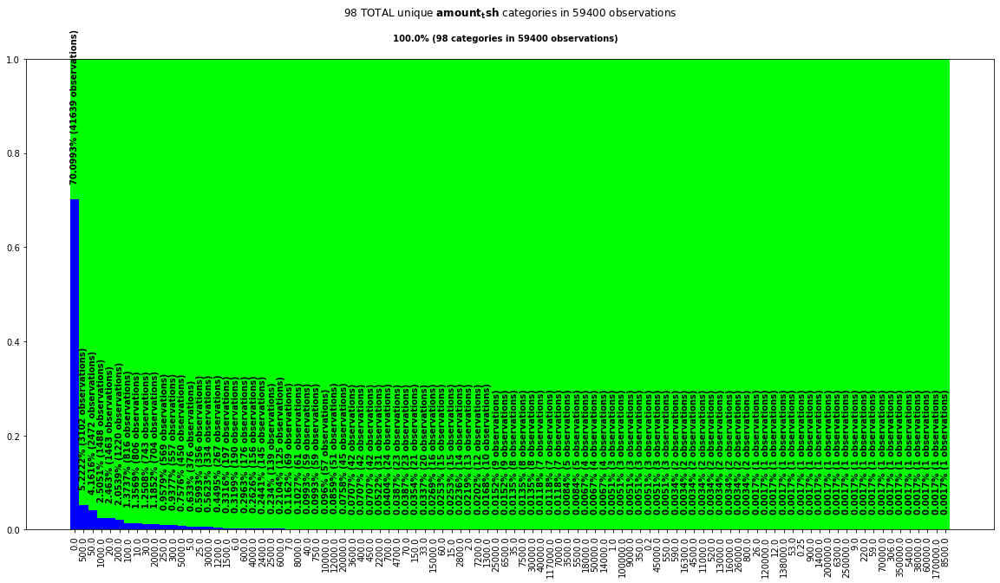

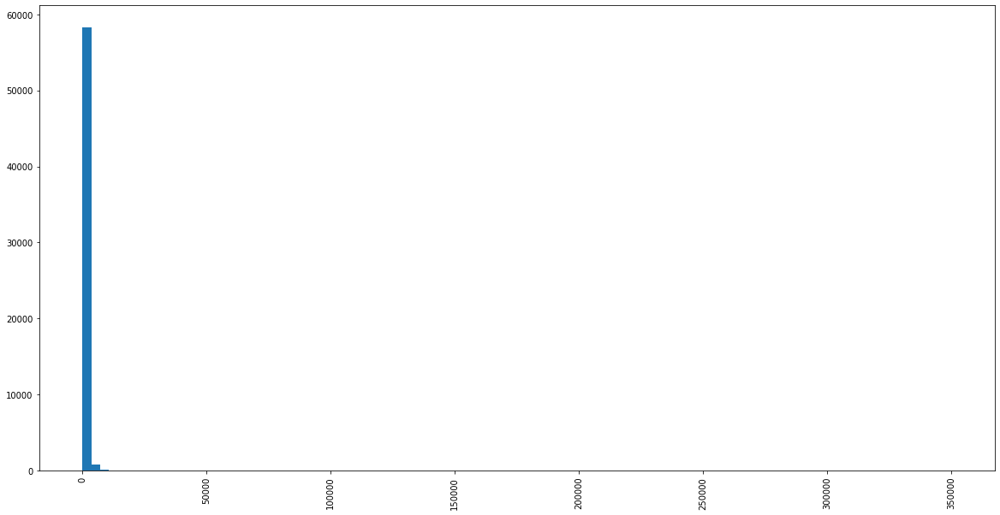

In [21]:
scjpnutils.analyze_distributions(
    X_labeled_clean, 
    'X_labeled', 
    'amount_tsh'
);

Now let's consider the possibility that <b>amount_tsh</b> is instead continuous and then let's look at its outliers if this is so.

In [22]:
labeled_with_target.groupby('status_group').amount_tsh.describe()

,count,mean,std,min,25%,50%,75%,max
status_group,,,,,,,,
functional,32259.0,461.798235,3889.735284,0.0,0.0,0.0,50.0,350000.0
functional needs repair,4317.0,267.071577,1925.026420,0.0,0.0,0.0,50.0,100000.0
non functional,22824.0,123.481230,1110.120571,0.0,0.0,0.0,0.0,117000.0


So, if we treat <b>amount_tsh</b> as a continuous feature, then its outliers' ratio is nearly 20%.  From above, we see that imputing the mean does nothing to improve this.  And imputing the median results in a still rather high outlier ratio of more than 11%.  The same holds true if we impute the mode.

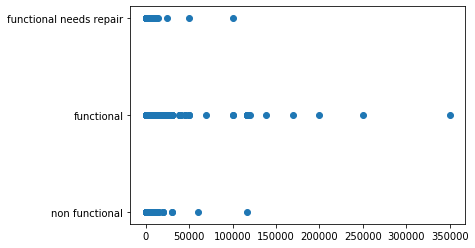

In [23]:
plt.figure()
plt.scatter(labeled_with_target.amount_tsh, labeled_with_target.status_group)
plt.show()

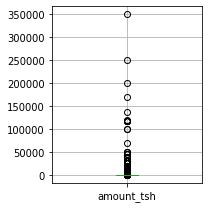

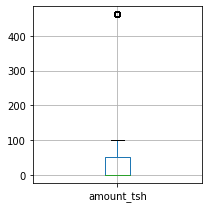

,feature,dtype,q1,q3,IQR_lower_bound,IQR_upper_bound,n_outliers,n_outliers_ratio,outliers_index
0,amount_tsh,float64,0.0,50.0,-75.0,125.0,7279,0.225642,"Int64Index([ 39, 48, 52, 55, 65,..."


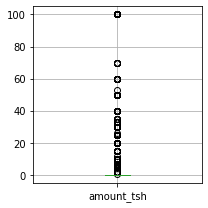

,feature,dtype,q1,q3,IQR_lower_bound,IQR_upper_bound,n_outliers,n_outliers_ratio,outliers_index
0,amount_tsh,float64,0.0,0.0,0.0,0.0,5274,0.163489,"Int64Index([ 3, 5, 19, 22, 36,..."


In [24]:
scjpnutils.analyze_outliers_detailed(
    labeled_with_target.query("status_group=='functional'"), 
    "labeled_with_target.query(\"status_group=='functional'\")", 
    'amount_tsh', 
    top_percentile=70, 
    outlier_ratio_reduction_threshold=.10
);

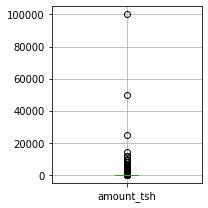

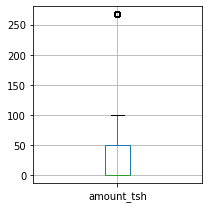

,feature,dtype,q1,q3,IQR_lower_bound,IQR_upper_bound,n_outliers,n_outliers_ratio,outliers_index
0,amount_tsh,float64,0.0,50.0,-75.0,125.0,950,0.22006,"Int64Index([ 20, 129, 326, 462, 489,..."


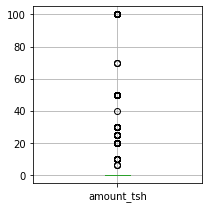

,feature,dtype,q1,q3,IQR_lower_bound,IQR_upper_bound,n_outliers,n_outliers_ratio,outliers_index
0,amount_tsh,float64,0.0,0.0,0.0,0.0,319,0.073894,"Int64Index([ 179, 381, 551, 688, 793,..."


In [25]:
scjpnutils.analyze_outliers_detailed(
    labeled_with_target.query("status_group=='functional needs repair'"), 
    "labeled_with_target.query(\"status_group=='functional needs repair'\")", 
    'amount_tsh', 
    top_percentile=70, 
    outlier_ratio_reduction_threshold=.10
);

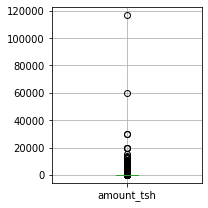

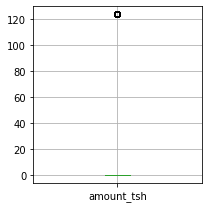

,feature,dtype,q1,q3,IQR_lower_bound,IQR_upper_bound,n_outliers,n_outliers_ratio,outliers_index
0,amount_tsh,float64,0.0,0.0,0.0,0.0,3939,0.172581,"Int64Index([ 11, 31, 66, 68, 91,..."


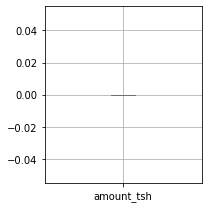

,feature,dtype,q1,q3,IQR_lower_bound,IQR_upper_bound,n_outliers,n_outliers_ratio,outliers_index
0,amount_tsh,float64,0.0,0.0,0.0,0.0,0,0.0,"Int64Index([], dtype='int64', name='id')"


In [26]:
scjpnutils.analyze_outliers_detailed(
    labeled_with_target.query("status_group=='non functional'"), 
    "labeled_with_target.query(\"status_group=='non functional'\")", 
    'amount_tsh', 
    top_percentile=70, 
    outlier_ratio_reduction_threshold=.10
);

Now let's move on to feature kind <b>pump_age_at_observation_date</b>.

<p><br><br>

In [27]:
display_feature_kind('pump_age_at_observation_date')

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,date_recorded,object,356,"[2002-10-14, 2004-01-07, 2004-03-01, 2004-03-0...",0.005993,99.40,0,0.0,None
1,construction_year,int64,55,"[0, 1960, 1961, 1962, 1963, 1964, 1965, 1966, ...",0.000926,99.91,0,0.0,None


Here, our goal is to engineer a new feature (as described).

There is one important question to highlight beforehand: <b><i>if</i> it occurs, what does a <u>negative</u> pump age mean</b>?

#### Feature Analysis: *date_recorded*

It has no null/missing values.  

This feature clearly should be a `date` type but is a `string`.

We'll convert it to a `date` type accordingly.

In [28]:
X_labeled_clean.date_recorded.min()

'2002-10-14'

In [29]:
X_labeled_clean.date_recorded.max()

'2013-12-03'

In [30]:
ft_date_recorded_to_date = FunctionTransformer(lambda X: scjpnutils.convert_col_to_date_type(X, 'date_recorded'), validate=False)
X_labeled_clean = ft_date_recorded_to_date.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['convert feature to datetime type: date_recorded', ft_date_recorded_to_date])

In [31]:
X_labeled_clean.date_recorded.value_counts()

2011-03-15    572
2011-03-17    558
2013-02-03    546
2011-03-14    520
2011-03-16    513
             ... 
2013-01-01      1
2011-09-11      1
2011-09-14      1
2011-09-27      1
2011-09-12      1
Name: date_recorded, Length: 356, dtype: int64

Let's have a look at the distribution just to ensure there is nothing wonky about it.

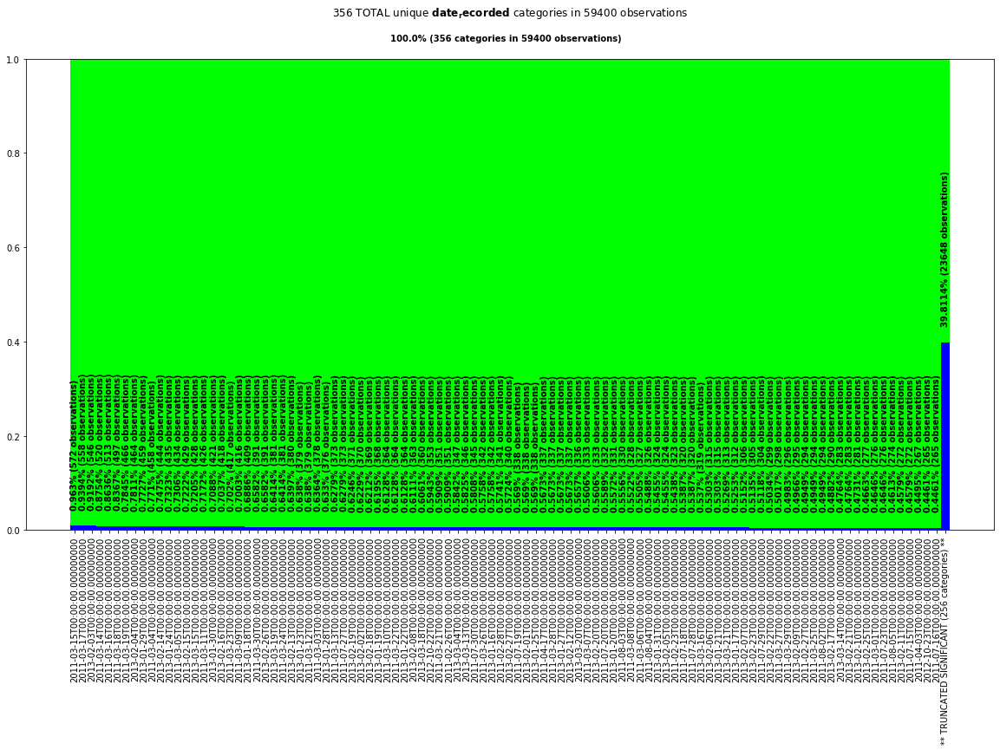

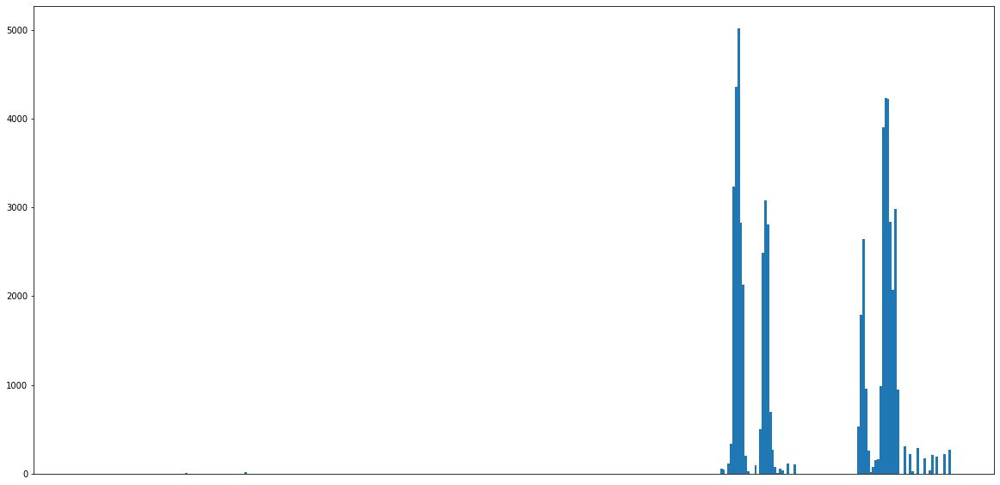

In [32]:
scjpnutils.analyze_distributions(
    X_labeled_clean, 
    'X_labeled_clean', 
    'date_recorded'
);

There are some older <b>date_recorded</b> values but, for the most part, everything looks good so we'll move on to <b>construction_year</b>.

#### Feature Analysis: *construction_year*

It has no null/missing values.  

This feature clearly should be a `date` type but is an `int`.

We'll convert it to a `date` type accordingly.

We notice there is a 0 <b>construction_year</b> value.  

This will cause problems for us so we need to replace it with a meaningful value that doesn't otherwise disturb the distribution.

Note that this MUST be done prior to conversion to `date` type.

<p><br>
Additionally, we need to address the "<b><i>if</i> it occurs, what does a <u>negative</u> pump age mean</b>?" question...

This circumstance occurs when <b>construction_year</b> > <b>date_recorded</b>.

Let's take a quick look at the value counts.

In [33]:
X_labeled_clean.construction_year.value_counts()

0       20709
2010     2645
2008     2613
2009     2533
2000     2091
2007     1587
2006     1471
2003     1286
2011     1256
2004     1123
2012     1084
2002     1075
1978     1037
1995     1014
2005     1011
1999      979
1998      966
1990      954
1985      945
1980      811
1996      811
1984      779
1982      744
1994      738
1972      708
1974      676
1997      644
1992      640
1993      608
2001      540
1988      521
1983      488
1975      437
1986      434
1976      414
1970      411
1991      324
1989      316
1987      302
1981      238
1977      202
1979      192
1973      184
2013      176
1971      145
1960      102
1967       88
1963       85
1968       77
1969       59
1964       40
1962       30
1961       21
1965       19
1966       17
Name: construction_year, dtype: int64

In order to find all observations where <b>construction_year</b> > <b>date_recorded</b>, we must convert <b>construction_year</b> to a `date` type to make it comparable to <b>date_recorded</b>.  

But this presents an odd situation since the ability to do so requires handling 0-valued <b>construction_year</b> observations FIRST!

So how do we choose an appropriate replacement semantic?  Let's take a look at some simple statistics.

In [34]:
X_labeled_clean.construction_year.describe()

count    59400.000000
mean      1300.652475
std        951.620547
min          0.000000
25%          0.000000
50%       1986.000000
75%       2004.000000
max       2013.000000
Name: construction_year, dtype: float64

We see that replacing 0 with the mean value is a bad idea since this will map all of those 0-valued <b>construction_year</b> observations to an unrealistic year (1300)!  We might think that replacing with the median can work - and it can - but then, since our goal is to track pump age (at the time the observation was recorded), the computed pump age (distribution) will be thrown off.

So let's analyze the distribution of values WITHOUT 0.  We will compare this to the distribution after replacement.

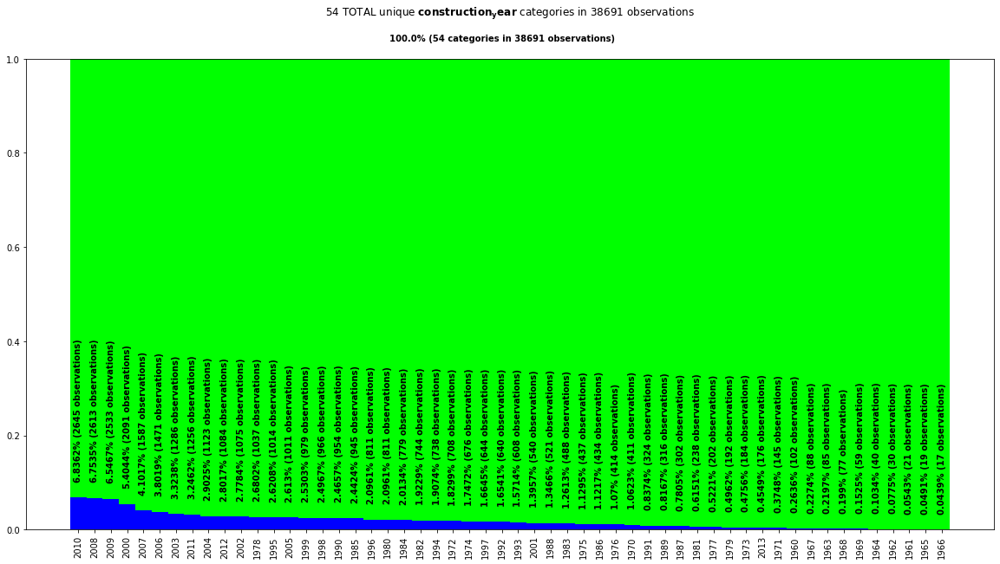

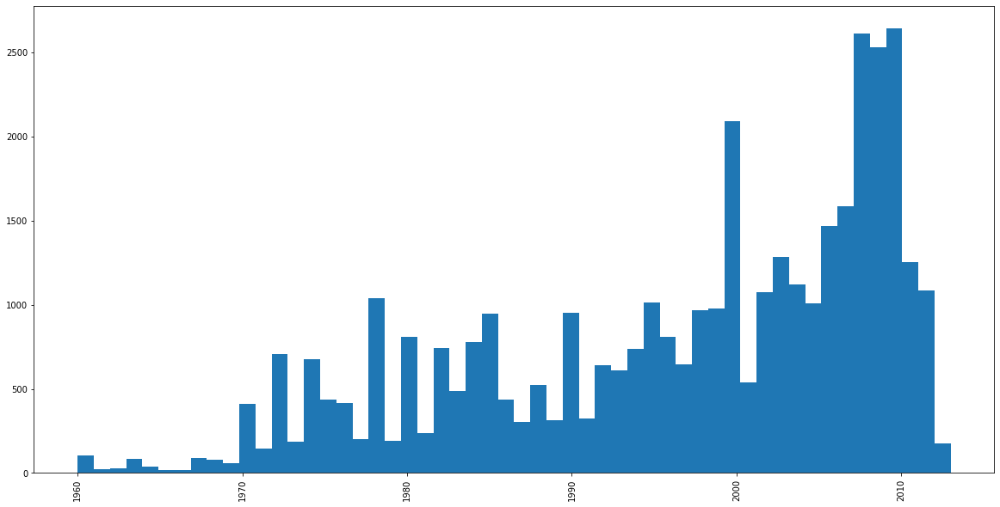

In [35]:
X_labeled__ct_yr_no_0 = X_labeled_clean[X_labeled_clean.construction_year != 0]
scjpnutils.analyze_distributions(
    X_labeled__ct_yr_no_0, 
    'X_labeled__ct_yr_no_0', 
    'construction_year'
);

In [36]:
X_labeled__ct_yr_no_0.construction_year.describe()

count    38691.000000
mean      1996.814686
std         12.472045
min       1960.000000
25%       1987.000000
50%       2000.000000
75%       2008.000000
max       2013.000000
Name: construction_year, dtype: float64

The mean <b>construction_year</b> is around 1997 and the median is 2000.  Replacing <b>construction_year</b> with either of these could work.  BUT, we now have to think about the goal of this sub-exercise: to track pump age at the time of the observation recording.  Recall that <b>construction_year</b> 0 essentially represents the unknown.  By replacing this value with ANY value whatsoever will create a synthetic and known pump age, derived from a <b>construction_year</b> that was previously unknown.  So how do we resolve this?

We might resolve this by replacing 0 <b>construction_year</b> with the OLDEST (minimum) <b>date_recorded</b>.

This will ensure that the new <b>pump_age_at_observation_date</b> is at best 0 (years) at and, at worst, $most\_recent(date\_recorded) - oldest(date\_recorded)$.

In [37]:
def replace_0_construction_year_with_min_date_recorded(df):
    df_copy = df.copy()
    replace_0_construction_year_rules = {
        'construction_year': [{
            'missing_values': 0, 
            'strategy': 'constant', 
            'fill_value': df_copy.date_recorded.min().year
        }]
    }
    svt_0_construction_year = SimpleValueTransformer(replace_0_construction_year_rules)
    df_copy = svt_0_construction_year.fit_transform(df_copy)
    return df_copy

ft_replace_0_construction_year_with_min_date_recorded = FunctionTransformer(lambda X: replace_0_construction_year_with_min_date_recorded(X), validate=False)
X_labeled_clean__0_construction_year_replaced_with_min_date_recorded = ft_replace_0_construction_year_with_min_date_recorded.fit_transform(X_labeled_clean)

# DON'T add this step to the pipeline yet since we are not yet committed to do this - it is for analysis ONLY
# pipeline_data_preprocessor.steps.append(['replace 0 with minimum date_recorded: construction_year', ft_replace_0_construction_year_with_min_date_recorded]) # not yet

Now we should be able to safely convert <b>construction_year</b> to `date` type. 

In [38]:
ft_construction_year_to_date = FunctionTransformer(lambda X: scjpnutils.convert_col_to_date_type(X, 'construction_year', format="%Y"), validate=False)
X_labeled_clean__0_construction_year_replaced_with_min_date_recorded = ft_construction_year_to_date.fit_transform(X_labeled_clean__0_construction_year_replaced_with_min_date_recorded)

# DON'T add this step to the pipeline yet since this step is predicated on handling 0-valued construction_year replacement and we have not yet settled on a final semantic - this is used for analysis ONLY; HOWEVER, we will be using ft_construction_year_to_date again since we know construction_year must be converted to a datetime type after all said and done
# pipeline_data_preprocessor.steps.append(['convert feature to datetime type: construction_year', ft_construction_year_to_date]) # not yet

Now let's find all observations where <b>construction_year</b> > <b>date_recorded</b>.

In [39]:
X_labeled_clean__0_construction_year_replaced_with_min_date_recorded[X_labeled_clean__0_construction_year_replaced_with_min_date_recorded['construction_year']>X_labeled_clean__0_construction_year_replaced_with_min_date_recorded['date_recorded']][['construction_year', 'date_recorded']]

,construction_year,date_recorded
id,,
1251,2008-01-01,2004-12-01
5971,2007-01-01,2004-03-01
9195,2005-01-01,2004-03-01
15921,2009-01-01,2004-03-06
20198,2008-01-01,2004-05-01
20534,2009-01-01,2004-03-01
48759,2011-01-01,2004-06-01
53086,2009-01-01,2004-01-07
55069,2006-01-01,2004-12-01


How can this be?  From above, we saw that the oldest <b>date_recorded</b> is 2002-10-14.  Recall the semantic for 0-valued <b>construction_year</b> was to replace with the oldest <b>date_recorded</b> (2002-10-14).  Since no <b>construction_year</b> above has value 2002-10-14, this was not the problem.  So the reason for the above must be something else.  Could it be that either <b>construction_year</b> or <b>date_recorded</b> values are errors, or is it still yet something else?

One plausible explanation could be that <u><b>construction_year</b> tracks when construction completed and <b>date_recorded</b> tracks when it began</u>.

If this is indeed the case, and it seems likely it is, then our replacement semantic above was INCORRECT!  Therefore, for 0-valued <b>construction_year</b>, it seems the best we can do is replace <b>construction_year</b> with the observation's <b>date_recorded</b>.  This will yield a 0-value for <b>pump_age_at_observation_date</b>, which is acceptable since this likely represents the case that construction had begun at the time the observation was recorded but was not yet finished.  A 0-value for <b>pump_age_at_observation_date</b> captures this information.

But, then, how do we handle observations, such as those above, in which construction had begun but was not yet completed at the time the observation was recorded (<b>date_recorded</b>) BUT the recorder later updates the record when construction completes?  To be clear, we see that the observations above indicate the following:

1. At the time the observation was recorded, construction had begun but was not yet finished.
2. Then, upon completion of construction, the recorder evidently updated the record with the date construction finally did complete.

So, with that in mind, if we ALLOW <b>construction_year</b> > <b>date_recorded</b> - then <b>pump_age_at_observation_date</b> < 0 also captures the above information (which probably can have some impact on the predictive model)!

Let's put this into play!

The first thing to do is to replace 0-valued <b>construction_year</b> with the observation's <b>date_recorded</b>.

In [40]:
# this is a very specialized function which has intimate knowledge of both construction_year and date_recorded
# it assumes date_recorded has already been converted to datetime
# it assumes construction_year is still and int - i.e. has not yet been converted to datetime
# for 0-valued construction_year, it will extract the year (as an int) from date_recorded to use as a replacement
def replace_0_construction_year_with_date_recorded(df, suppress_output=True):
    df_copy = df.copy()
    df_copy_0_construction_year = df_copy[df_copy.construction_year==0]
    if not suppress_output:
        display(HTML(f"<h3>BEFORE replacing 0-valued <i>construction_year</i> (with <i>date_recorded</i>):</h3>"))
        display(HTML(df_copy.loc[df_copy_0_construction_year.index][['date_recorded', 'construction_year']].to_html(notebook=True, justify='left', max_rows=25)))
    df_copy['dt_recorded_yr'] = df_copy.date_recorded.dt.year
    df_copy['construction_year'] = np.where(df_copy['construction_year']==0, df_copy['dt_recorded_yr'], df_copy['construction_year'])
    df_copy = df_copy.drop('dt_recorded_yr', axis=1)
    if not suppress_output:
        display(HTML(f"<h3>AFTER replacing 0-valued <i>construction_year</i> (with <i>date_recorded</i>):</h3>"))
        display(HTML(df_copy.loc[df_copy_0_construction_year.index][['date_recorded', 'construction_year']].to_html(notebook=True, justify='left', max_rows=25)))
    return df_copy, df_copy_0_construction_year.index

ft_replace_0_construction_year_with_date_recorded = FunctionTransformer(lambda X: replace_0_construction_year_with_date_recorded(X)[0], validate=False)

# test
_, at_index = replace_0_construction_year_with_date_recorded(X_labeled_clean, suppress_output=False)

,date_recorded,construction_year
id,,
0,2012-11-13,0
2,2011-03-27,0
4,2011-03-22,0
5,2011-02-26,0
6,2012-10-20,0
7,2011-03-23,0
8,2011-04-07,0
9,2011-07-12,0
15,2012-11-06,0


,date_recorded,construction_year
id,,
0,2012-11-13,2012
2,2011-03-27,2011
4,2011-03-22,2011
5,2011-02-26,2011
6,2012-10-20,2012
7,2011-03-23,2011
8,2011-04-07,2011
9,2011-07-12,2011
15,2012-11-06,2012


The transformation looks good.  So let's apply it and commit it to the `Pipeline`.

In [41]:
X_labeled_clean = ft_replace_0_construction_year_with_date_recorded.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['replace 0 with date_recorded: construction_year', ft_replace_0_construction_year_with_date_recorded])

And don't forget to convert <b></b> to `date` type...

In [42]:
X_labeled_clean = ft_construction_year_to_date.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['convert feature to datetime type: construction_year', ft_construction_year_to_date])

In [43]:
# this function assumes that:
#    ft_replace_0_construction_year_with_date_recorded has already transformed construction_year
#    ft_construction_year_to_date has already transformed construction_year
def add_pump_age_feature(df):
    df_copy = df.copy()

    df__pump_age__debug = df_copy[['date_recorded', 'construction_year']].copy()

    # now simply compute date diff (in years)
    df__pump_age__debug['pump_age'] = df__pump_age__debug['date_recorded'].dt.year - df__pump_age__debug['construction_year'].dt.year
    df_copy['pump_age'] = df__pump_age__debug['pump_age']

    return df_copy

# test
X_labeled_clean__with_pump_age = add_pump_age_feature(X_labeled_clean)
X_labeled_clean__with_pump_age[['date_recorded', 'construction_year', 'pump_age']]

,date_recorded,construction_year,pump_age
id,,,
0,2012-11-13,2012-01-01,0
1,2011-03-05,2008-01-01,3
2,2011-03-27,2011-01-01,0
3,2013-06-03,1999-01-01,14
4,2011-03-22,2011-01-01,0
...,...,...,...
74240,2013-03-22,2012-01-01,1
74242,2011-04-12,2011-01-01,0
74243,2012-11-13,1983-01-01,29


We're almost ready to apply and commit this step.  The last thing we need to do is make sure that negative <b>pump_age</b> (for the case when construction was still under way at the time the observation was recorded and then later updated) is captured appropriately.

In [44]:
X_labeled_clean__with_pump_age[X_labeled_clean__with_pump_age['pump_age']<0][['date_recorded', 'construction_year', 'pump_age']]

,date_recorded,construction_year,pump_age
id,,,
1251,2004-12-01,2008-01-01,-4
5971,2004-03-01,2007-01-01,-3
9195,2004-03-01,2005-01-01,-1
15921,2004-03-06,2009-01-01,-5
20198,2004-05-01,2008-01-01,-4
20534,2004-03-01,2009-01-01,-5
48759,2004-06-01,2011-01-01,-7
53086,2004-01-07,2009-01-01,-5
55069,2004-12-01,2006-01-01,-2


Finally, let's have a look at the distribution of <b>pump_age</b>.

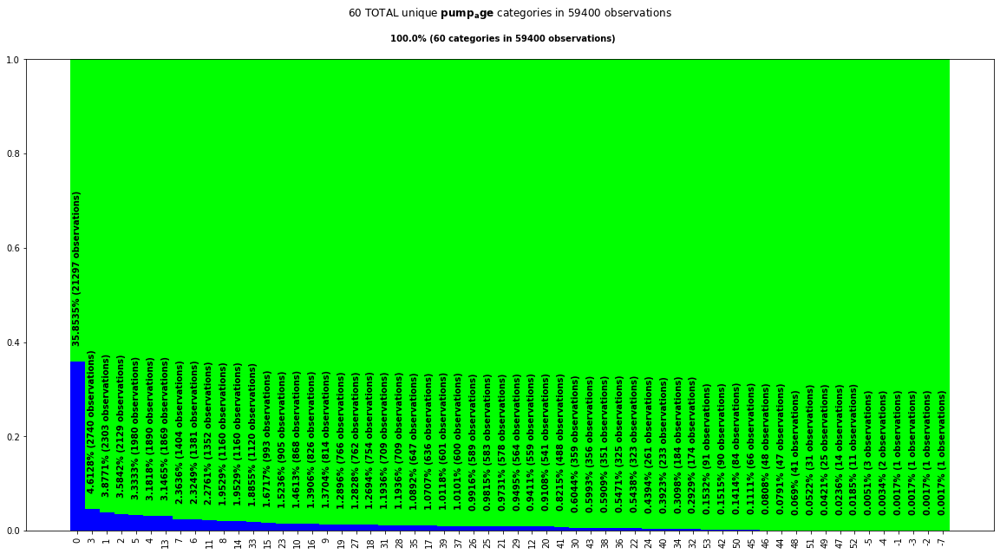

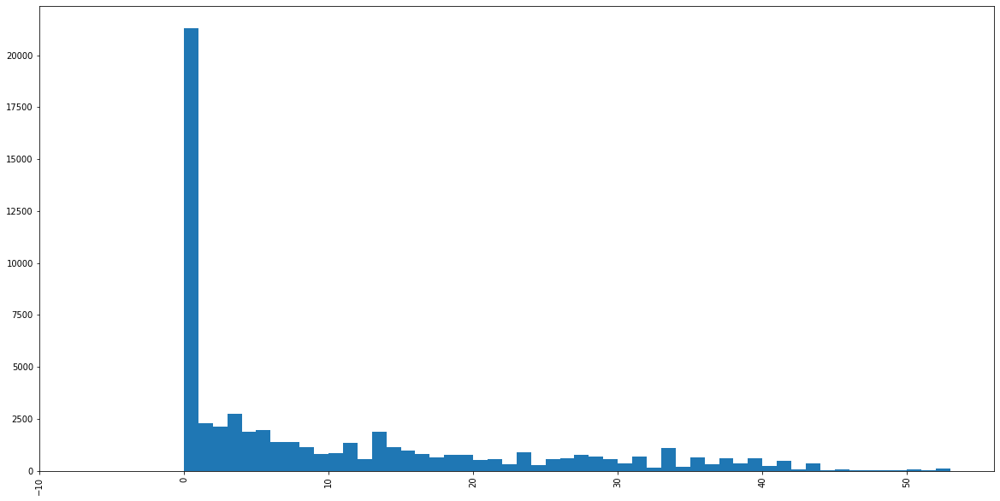

In [45]:
scjpnutils.analyze_distributions(
    X_labeled_clean__with_pump_age, 
    'X_labeled_clean__with_pump_age', 
    'pump_age'
);

This all looks great.

Let's now apply and commit this step to the `Pipeline`.

In [46]:
ft_add_pump_age_feature = FunctionTransformer(lambda X: add_pump_age_feature(X), validate=False)
X_labeled_clean = ft_add_pump_age_feature.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['add feature: pump_age', ft_add_pump_age_feature])

Finally, since we extracted "more" information from <b>date_recorded</b> and <b>construction_year</b> than they both individually contained, we will drop them from consideration in the cleaned data set so that the final classification will not be overfit.

In [47]:
dct_date_recorded_and_construction_year = DropColumnsTransformer(['date_recorded', 'construction_year'])
X_labeled_clean = dct_date_recorded_and_construction_year.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['drop potential overfit columns: date_recorded and construction_year', dct_date_recorded_and_construction_year])

Now let's move on to feature kind <b>funder</b>.

<p><br><br>

In [48]:
display_feature_kind('funder')

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,funder,object,1898,"[0, A/co Germany, Aar, Abas Ka, Abasia, Abc-ih...",0.031953,96.8,3635,0.061195,"Int64Index([ 22, 28, 80, 119, 120,..."


#### Feature Analysis: *funder*

There are a fair amount (3365) of null/missing values.

Being an object with a small percentage of unique values, this feature is likely categorical.

Let's have a look at its value counts that aren't null/missing.

In [49]:
X_labeled_clean.funder.value_counts()

Government Of Tanzania    9084
Danida                    3114
Hesawa                    2202
Rwssp                     1374
World Bank                1349
                          ... 
Ringo                        1
Unp/aict                     1
Mtewe                        1
Ur                           1
Haam                         1
Name: funder, Length: 1897, dtype: int64

But we need to handle those null/missing values in order to get a clearer picture.

So what do we replace null/missing values with??

Let's see if <b>funder</b> contains common "none" type words...

In [50]:
# let's make this easier by normalizing values to lower-case...
def impute_lcase(df, feat):
    #exclude nulls since this may not have been done yet
    df_nulls_excluded = df[df[feat].isnull()==False]

    df_feat_with_ucase_vals = df_nulls_excluded.loc[df_nulls_excluded[feat].str.contains('[A-Z]+',regex=True)==True]
    if len(df_feat_with_ucase_vals) > 0:
        impute_lcase_rules = {}
        impute_lcase_rules[feat] = lambda v: v.lower()
        lt_lcase_cat_predictors = LambdaTransformer(impute_lcase_rules)
        df_lcased = lt_lcase_cat_predictors.fit_transform(df_feat_with_ucase_vals)
        return pd.concat([df_lcased, df[~df.index.isin(df_lcased.index)]], axis=0, ignore_index=False)
    else:
        return df

ft_impute_lcase_funder = FunctionTransformer(lambda X: impute_lcase(X, 'funder'), validate=False)
X_labeled_funder_lcase = ft_impute_lcase_funder.fit_transform(X_labeled_clean)

# finally, check to see if there is an appropriate existing value in X_labeled.funder to indicate null - e.g. 'none', 'unknown', 'not known', etc.
scjpnutils.index_of_values(X_labeled_funder_lcase, 'X_labeled', 'funder', ['none', 'unknown', 'not known'])

(array([  281,  4345,  6290,  6803,  8630,  9009, 10616, 11662, 12834,
        13617, 13967, 14810, 18600, 19271, 19904, 20683, 21318, 23527,
        25447, 26355, 29850, 30216, 30530, 36650, 37502, 37709, 38830,
        38882, 39610, 42469, 46839, 50508, 54590]),
 array(['not known', 'none', 'unknown'], dtype=object))

Well now... we have some work to do.  Not only do we have null/missing values to contend with, we also have multiple non-null representations of the same concept.

Actually, "unknown" (or "not known") is not really the same concept as "none", now is it?

Let's deal with null/missing values first.

Before we do that, we will apply the above step (imputing lower-case) and commit it to the `Pipeline`.

In [51]:
X_labeled_clean = ft_impute_lcase_funder.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['impute lower case: funder', ft_impute_lcase_funder])

Now that that's done, our job of imputing the appropriate value ("none") on null/missing <b>funder</b> values will be much easier.

Note that we will adopt this semantic in general for ALL null/missing `string`-type variable values - i.e. <b><u>ALL</u> null/missing `string`-type variable values will be replaced with "none"</b>.

Creating the boiler-plate for this step is straight-forward (we use `SimpleValueTransformer`).  Let's do so now, apply it, and commit it to the `Pipeline`.

In [52]:
missing_string_value_replacement = "none" # TO DO: add this to the config!

replace_null_rules = {'funder': [{'missing_values': np.nan, 'strategy': 'constant', 'fill_value': missing_string_value_replacement}]}
svt_null_funder = SimpleValueTransformer(replace_null_rules)
X_labeled_clean = svt_null_funder.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['impute \'none\' for missing values: funder', svt_null_funder])

Now, since we noticed there are multiple values that represent an unknown <b>funder</b> - values are "unknown" and "not known" - let's replace one with the other.

Replacing "not known" with "unknown" seems like the logical thing to do - one word is better than two for our purpose.

In [53]:
replace_same_concept_words = {'funder': [{'missing_values': "not known", 'strategy': 'constant', 'fill_value': "unknown"}]}
svt_not_known_funder = SimpleValueTransformer(replace_same_concept_words)
X_labeled_clean = svt_not_known_funder.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['replace same concept words: funder', svt_not_known_funder])

With null/missing values replaced with "none" and "not known" values replaced with "unknown", we are in a position to get an accurate view of the distribution of "unique" values.  

Later we will see that there are still many different "single-entity" representations of <b>funder</b> (as well as other categorical variable categories) that can only be addressed by more advanced techniques - `TF-IDF` with `KMeans` Clustering natural language analysis and processing.  It's not a straightforward task to find "duplicates" without these techniques.  Therefore, we will not truly be observing "unique" values in the following.

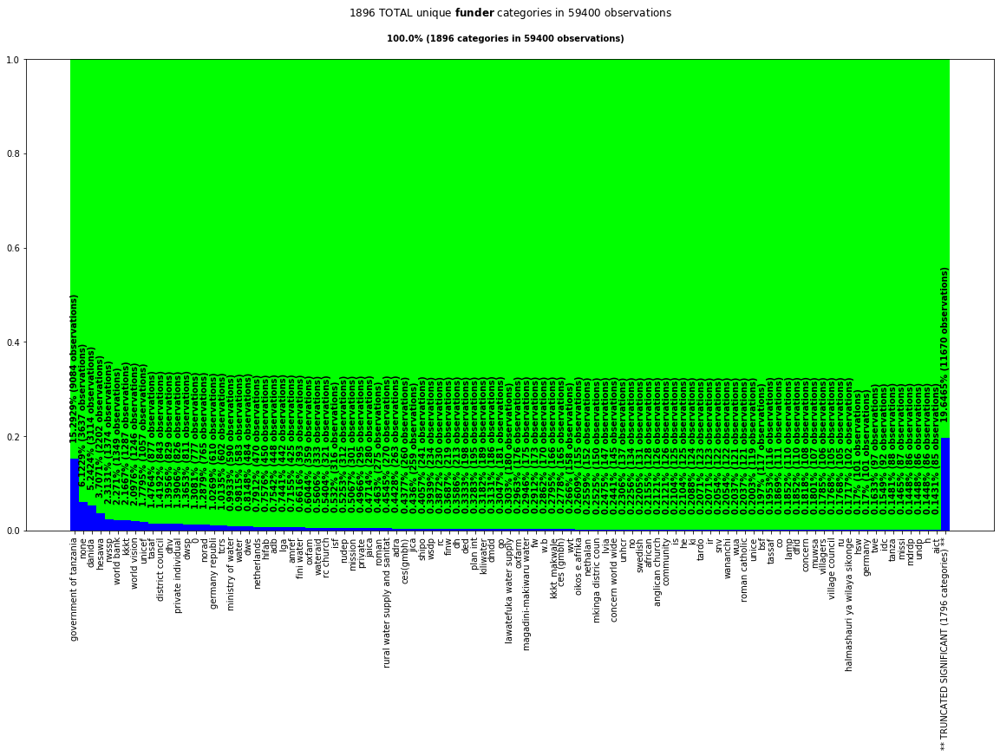

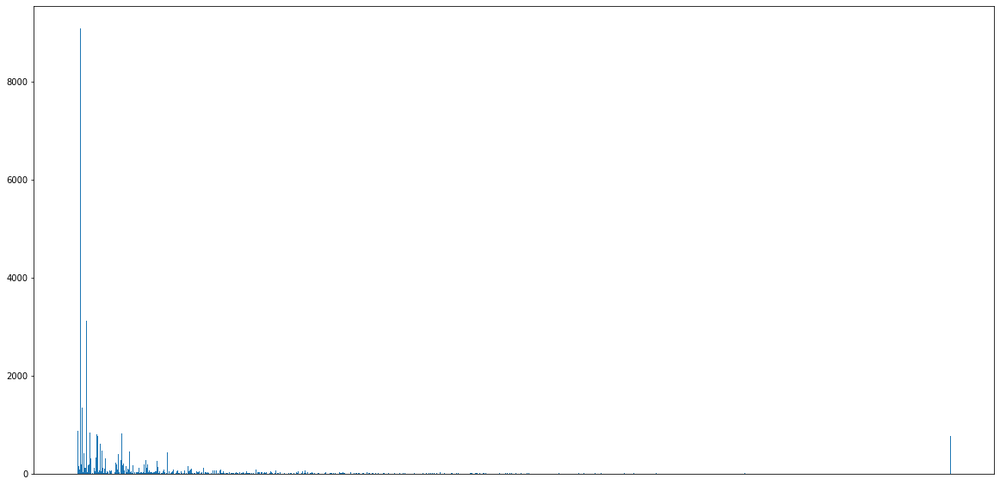

In [54]:
scjpnutils.analyze_distributions(
    X_labeled_clean, 
    'X_labeled_clean', 
    'funder'
);

Note that this categorical variable supposedly has 1896 "unique" categories!  That's quite a lot!  But are they really unique?

To see the problem that only NLP can solve in this case, consider the following.

In [55]:
scjpnutils.analyze_non_alphanumeric_strings(X_labeled_clean[['funder']], 'X_labeled_clean <i>funder</i>');

,feature,n_unique,n_non_alphanumeric_str,non_alphanumeric_str_index
0,funder,1896,22311,"Int64Index([ 3, 6, 11, 12, 16,..."


Questions:

1. Is there really a funder named "action in a"?  Seems like a typo to me.
2. How about "adp/w"?
3. And look at all of those so-called "unique" <b>funder</b>s that start with the word "african" - in particular, are "african development bank" and "african development foundation" really DIFFERENT/unique entities?  It's hard to say.  Another example in this subset is "african realief committe of ku" and "african relie" - to me, this looks like a data entry error wherein the recorder pressed ENTER on his/her keyboard too soon; regardless, these two values appear as unique entities... not good in any case.
4. Perhaps a more blatant example is: "arab community" vs. "arabs community"; once again, these clearly reference the same real-world entity but are represented in the data as two different, "unique" <b>funder</b> entities.

You see the problem?  If we have seen this much "duplication" of single entities with different representations in only the first handful of examples, then this problem must be pervasive throughout this categorical variable... indeed, throughout ALL categorical variables (with high cardinality).

Thus, an <i>unsupervised learning</i> algorithm involving `TF-IDF` combined with `KMeans Clustering` has been developed to address this natural language processing problem.  I will not duplicate the details of that research herein - if you are interested in the details, they can be found in the separate <i>High Cardinality Text-based Categorical Variable Classification</i> Jupyter notebook ([CategoricalClassification-Algo.ipynb](CategoricalClassification-Algo.ipynb)) - but I will now apply the results, encapsulated in the `tfidf_kmeans_classify_feature` function, used below.

Note that this function is applied sparingly and only to those categorical variables with initially high cardinality.  

For example, <b>funder</b> has 1896 so-called "unique" categories - thus, its cardinality is very high.  Recall that the main point in this approach is to avoid One-Hot Encoding since Gradient-Boosted Tree Classifiers do not handle categorical variables with high cardinality <i>that have been One-Hot Encoded</i> very well.  ([One-Hot Encoding is making your Tree-Based Ensembles worse, here’s why?](https://towardsdatascience.com/one-hot-encoding-is-making-your-tree-based-ensembles-worse-heres-why-d64b282b5769)).  Not only will they suffer in accuracy relative to, for example, Label Encoding, but processing will take a VERY LOOONG TIME since a new column is added for each unique category (beyond the first, of course)!  In this example (<b>funder</b>), 1894 columms columns would be added via One-Hot Encoding if we did not do additional text processing (aside from what has been done already).  So, let's assume <b>funder</b> is the ONLY categorical variable and there are, let's say 10 continuous variables.  That's a matrix with $10 \times 54988 = 549880$ cells.  With just this one single categorical variable One-Hot Encoded, the size of the matrix increases to $549880 + (1894 \times 54988) = 549880 + 104147272 = 104697152$ cells!  Without going into too much detail, if we consider the memory footprint (not just in terms of cell-count), we jump from a few megabytes to literally Gigabytes of RAM required to hold this additional One-Hot Encoded data in memory.  If we add more high cardinality categorical variables to the mix, it gets UGLY really fast.  GridSearch becomes intractible as it can take literally days, if not weeks to complete given a paremeter grid beyond the most basic since building a SINGLE gradient-boosted-tree model can take hours.

Anyway, let's get back to it.  

Final note, here: since using the `tfidf_kmeans_classify_feature` function is basically a task involving building submodels - we actually build a `KMeans` model - there are hyper-parameters involved.  There are many hyper-parameters one can tune with `KMeans` but this has been abstracted away with the exception of the `n_clusters` hyper-parameter.  This is exposed only indirectly.  Instead, one *may* manipulate the mean cluster-size which should be related to the measure of disorder (entropy) after `TF-IDF` vectorization.  In fact, the default behavior is to do exactly that.  The idea goes like this:

1. `TF-IDF` vectorize the corpus of unique values.
2. Measure the entropy of the probability distribution `TF-IDF` vectorization creates - entropy represents "how many questions we must ask to get the right answer (given a probability distribution)" (see https://www.youtube.com/watch?v=2s3aJfRr9gE for a friendly explanation).
3. This effectively gives us the <u>mean</u> size a cluster `KMeans` creates should be.
4. So `KMeans` `n_clusters`, in this case, is defined as $n\_clusters = math.ceil(\frac{len(corpus)}{mean\_cluster\_size = entropy})$.

In [56]:
# ft_tfidf_kmeans_classify_funder = FunctionTransformer(lambda X: scjpnsubmodels.tfidf_kmeans_classify_feature(
#         X, 
#         '', 
#         'funder', 
#         verbose=0
#     )[0], 
#     validate=False
# )
# X_labeled_clean = ft_tfidf_kmeans_classify_funder.fit_transform(X_labeled_clean)

# # add this step to the pipeline
# pipeline_data_preprocessor.steps.append(['tfidf-kmeans-classify: funder', ft_tfidf_kmeans_classify_funder])

In [57]:
def target_encode(df, feat):
    target_encoder = TargetEncoderLOOTransformer(cols=[feat])
    ft_target_encoder = FunctionTransformer(lambda X: target_encoder.fit_transform(X, labels_encoded.status_group))
    return ft_target_encoder.fit_transform(X_labeled_clean), ft_target_encoder

X_labeled_clean, ft_target_encode_funder = target_encode(X_labeled_clean, 'funder')

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['target encode: funder', ft_target_encode_funder])

Let's move on to feature kind <b>gps_height</b>.

<p><br><br>

In [58]:
display_feature_kind('gps_height')

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,gps_height,int64,2428,"[-90, -63, -59, -57, -55, -54, -53, -52, -51, ...",0.040875,95.91,0,0.0,None


#### Feature Analysis: *gps_height*

It has no null/missing values.

<b>gps_height</b> is very likely categorical (ordinal), even though it is numeric.

Let's have a look at its value counts.

In [59]:
X_labeled_clean.gps_height.value_counts()

 0       20438
-15         60
-16         55
-13         55
-20         52
         ...  
 2285        1
 2424        1
 2552        1
 2413        1
 2385        1
Name: gps_height, Length: 2428, dtype: int64

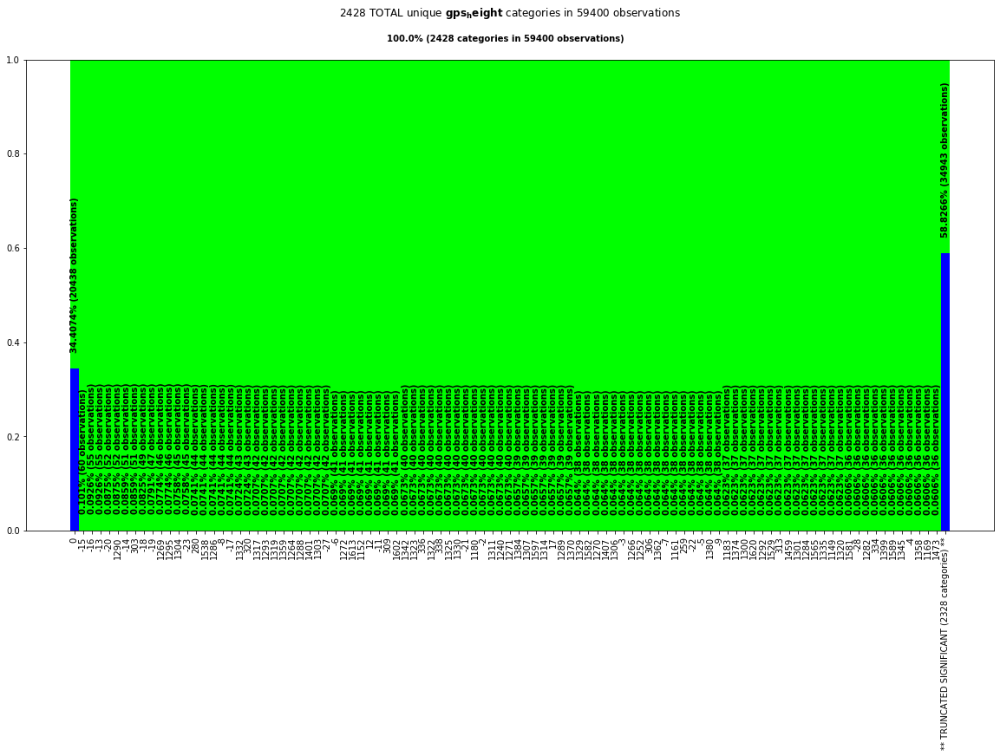

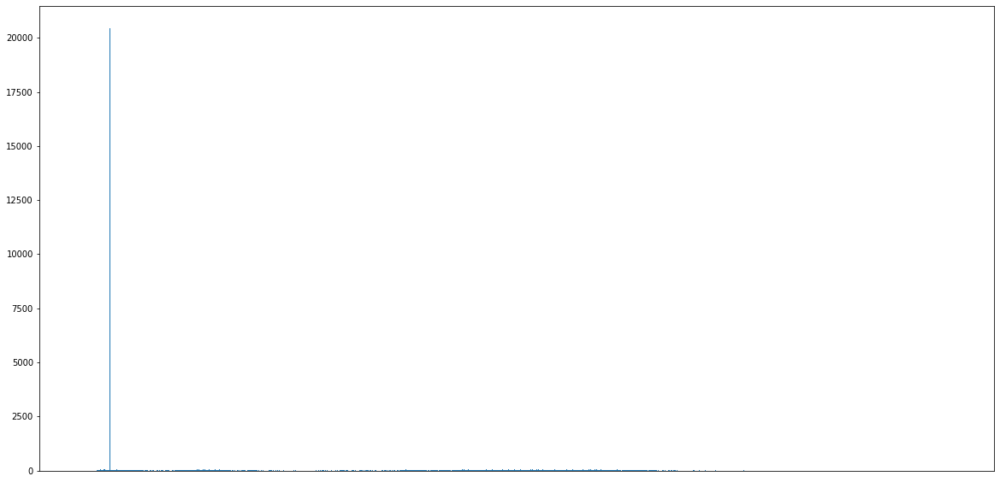

In [60]:
scjpnutils.analyze_distributions(
    X_labeled_clean, 
    'X_labeled', 
    'gps_height'
);

Now let's consider the possibility that <b>gps_height</b> is instead continuous and then let's look at its outliers if this is so.

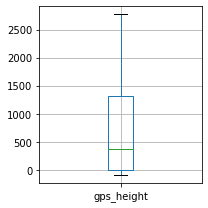

In [61]:
scjpnutils.analyze_outliers_detailed(
    X_labeled_clean, 
    'X_labeled', 
    'gps_height', 
    top_percentile=34, 
    outlier_ratio_reduction_threshold=.10
);

There is not much going on here.  Whether we treat <b>gps_height</b> as a categorical (ordinal) or continuous, the result is the same since, continuously speaking, it has no outliers.

So we will simply leave it as is since it requires no transformations whatsoever.  NICE!

Let's move on to feature kind <b>installer</b>.

<p><br><br>

In [62]:
display_feature_kind('installer')

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,installer,object,2146,"[-, 0, A.D.B, AAR, ABASIA, ABD, ABDALA, ABDUL,...",0.036128,96.39,3655,0.061532,"Int64Index([ 1165, 1941, 5253, 6454, 7289,..."


#### Feature Analysis: *installer*

The first thing we notice is that there appears to be quite a bit of overlap in values between <b>funder</b> and <b>installer</b>.  That is not to say that data is duplicated since we haven't seen whether or not values are similar for a given single observation.  But let's finish our initial commentary based on high-level value analysis.

There are a fair amount (3655) of null/missing values.

Being an object with a small percentage of unique values, this feature is likely categorical.

Let's have a look at its value counts that aren't null/missing.

In [63]:
X_labeled_clean.installer.value_counts()

DWE                          17402
Government                    1825
RWE                           1206
Commu                         1060
DANIDA                        1050
                             ...  
Laizer                           1
TASAFcitizen and LGA             1
UNICRF                           1
Goldmain                         1
UMOJA DRILLING CONTRACTOR        1
Name: installer, Length: 2145, dtype: int64

With <b>installer</b>, we seem to suffer from more or less the same kinds of feature deficits as we did with <b>funder</b>.  So we take a similar approach.

First we need to handle those null/missing values.

Like we did with <b>funder</b>, let's see if <b>installer</b> contains common "none" type words...

In [64]:
ft_impute_lcase_installer = FunctionTransformer(lambda X: impute_lcase(X, 'installer'), validate=False)
X_labeled_clean = ft_impute_lcase_installer.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['impute lower case: installer', ft_impute_lcase_installer])

# finally, check to see if there is an appropriate existing value in X_labeled.funder to indicate null - e.g. 'none', 'unknown', 'not known', etc.
scjpnutils.index_of_values(X_labeled_clean, 'X_labeled', 'installer', ['none', 'unknown', 'not known'])

(array([  280,  4312,  8567,  8942, 10532, 11570, 13855, 18439, 20503,
        23327, 25233, 26137, 29598, 37196, 37399, 38513, 39280, 42120,
        52196, 54148, 54633, 54641, 54643, 54650, 54708, 54714, 54720,
        54743, 54746, 54753, 54794, 54810, 54812, 54832, 54851, 54880,
        54886, 54895, 54898, 54928, 54944, 54964, 54973, 54976, 54980]),
 array(['not known', 'unknown'], dtype=object))

Unlike <b>funder</b>, <b>installer</b> does NOT have a "none" category.

But exactly like <b>funder</b>, for <b>installer</b> there are also multiple values that represent an unknown <b>installer</b> - values are "unknown" and "not known" - let's replace one with the other.

And exactly like <b>funder</b>, for <b>installer</b>, we will replace "not known" with "unknown".

But, again, we need to handle null/missing values first.  Even though <b>installer</b> doesn't have an existing "none" category, we will introduce it and use it as the value replacement for null/missing values.

In [65]:
replace_null_rules = {'installer': [{'missing_values': np.nan, 'strategy': 'constant', 'fill_value': missing_string_value_replacement}]}
svt_null_installer = SimpleValueTransformer(replace_null_rules)
X_labeled_clean = svt_null_installer.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['impute \'none\' for missing values: installer', svt_null_installer])

And now "unknown" and "not known" values...

In [66]:
replace_same_concept_words = {'installer': [{'missing_values': "not known", 'strategy': 'constant', 'fill_value': "unknown"}]}
svt_not_known_installer = SimpleValueTransformer(replace_same_concept_words)
X_labeled_clean = svt_not_known_installer.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['replace same concept words: installer', svt_not_known_installer])

Now let's get an accurate view of the distribution of "unique" values.  

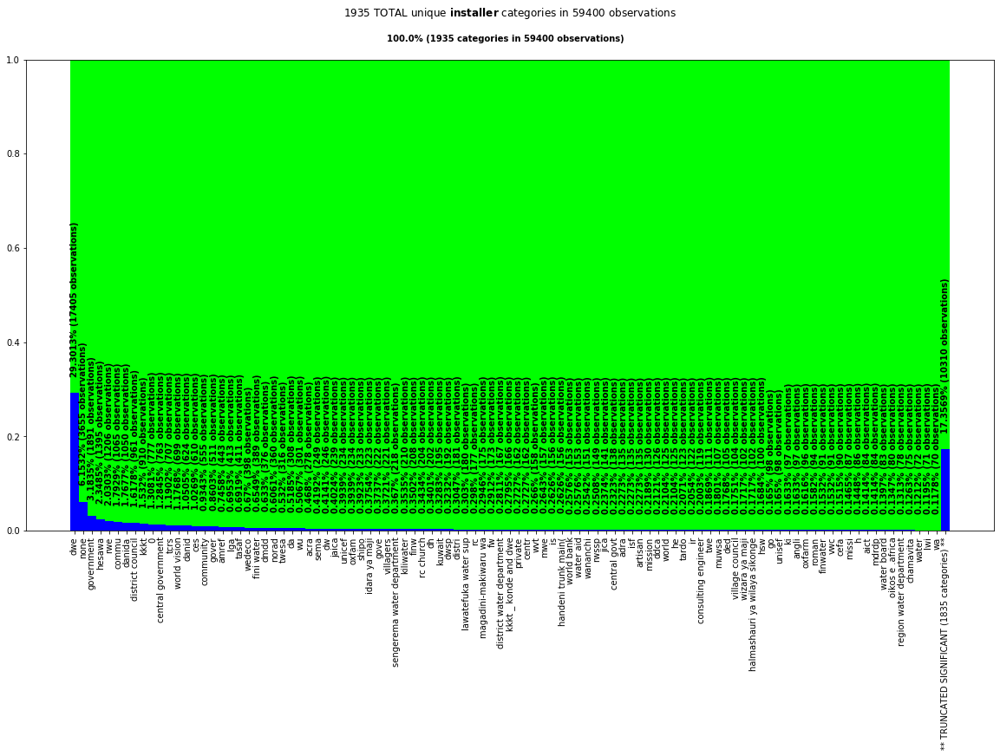

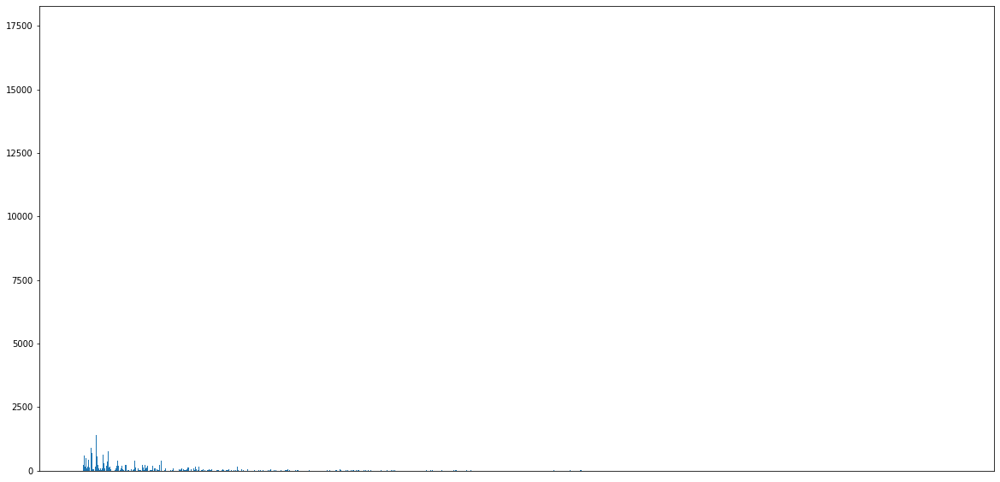

In [67]:
scjpnutils.analyze_distributions(
    X_labeled_clean, 
    'X_labeled_clean', 
    'installer'
);

Again, similar to <b>funder</b>, <b>installer<b/> supposedly has 1935 "unique" categories!  Again, it's quite a lot.  Certainly too many to One-Hot Encode.

We will again employ the `tfidf_kmeans_classify_feature` function to classify <b>installer</b>.

But before we do so, let's see how bad duplication is so we are sure it is indeed needed.

In [68]:
scjpnutils.analyze_non_alphanumeric_strings(X_labeled_clean[['installer']], 'X_labeled_clean <i>installer</i>');

,feature,n_unique,n_non_alphanumeric_str,non_alphanumeric_str_index
0,installer,1935,9543,"Int64Index([ 12, 27, 33, 35, 40,..."


Wow!  The "duplication" situation seems to be just as bad for <b>installer</b> as it was for <b>funder</b>!

It looks like we do need `tfidf_kmeans_classify_feature`.

In [69]:
# ft_tfidf_kmeans_classify_installer = FunctionTransformer(lambda X: scjpnsubmodels.tfidf_kmeans_classify_feature(
#         X, 
#         '', 
#         'installer', 
#         verbose=0
#     )[0], 
#     validate=False
# )
# X_labeled_clean = ft_tfidf_kmeans_classify_installer.fit_transform(X_labeled_clean)

# # add this step to the pipeline
# pipeline_data_preprocessor.steps.append(['tfidf-kmeans-classify: installer', ft_tfidf_kmeans_classify_installer])

In [70]:
# dct_installer = DropColumnsTransformer(['installer'])
# X_labeled_clean = dct_installer.fit_transform(X_labeled_clean)

# # add this step to the pipeline
# pipeline_data_preprocessor.steps.append(['drop potential overfit columns: installer', dct_installer])

In [71]:
X_labeled_clean, ft_target_encode_installer = target_encode(X_labeled_clean, 'installer')

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['target encode: installer', ft_target_encode_installer])

Let's move on to feature kind <b>gps_coordinates</b>.

<p><br><br>

In [72]:
display_feature_kind('gps_coordinates')

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,latitude,float64,57517,"[-11.64944018, -11.64837759, -11.58629656, -11...",0.968300,3.17,0,0.0,None
1,longitude,float64,57516,"[0.0, 29.6071219, 29.60720109, 29.61032056, 29...",0.968283,3.17,0,0.0,None


Since these really form ordered pairs, it doesn't make much sense to examine them separately.

Notice that there is a zero value in <b>longitude</b>.

In [73]:
X_labeled_with_0_lon = X_labeled_clean[X_labeled_clean['longitude']==0][['latitude', 'longitude']]
X_labeled_with_0_lon

,latitude,longitude
id,,
15,-2.000000e-08,0.0
50,-2.000000e-08,0.0
81,-2.000000e-08,0.0
137,-2.000000e-08,0.0
194,-2.000000e-08,0.0
...,...,...
54819,-2.000000e-08,0.0
58037,-2.000000e-08,0.0
58315,-2.000000e-08,0.0


Very interesting!  That definitely looks like a mistake.

In [74]:
X_labeled_with_0_lon.latitude.unique()

array([-2.e-08])

In [75]:
X_labeled_clean.latitude.min()

-11.64944018

In [76]:
X_labeled_clean.latitude.max() # but does this value occur with any longitude != 0.0?

-2e-08

To me this looks like some sort of floating point/rounding error occurred.

Let's just see if this value for <b>latitude</b> occurs with any <b>longitude</b> other than 0.0.

In [77]:
X_labeled_with_weird_lat = X_labeled_clean[(X_labeled_clean['latitude']==-2.e-08) & (X_labeled_clean['longitude']!=0.0)][['latitude', 'longitude']]
X_labeled_with_weird_lat

,latitude,longitude
id,,


It is, therefore, clear that <b>latitude</b> value -2e-08 should be replaced by 0.0.

In [78]:
X_labeled_clean.longitude.min()

0.0

In [79]:
X_labeled_clean.longitude.max()

40.34519307

So this is an easy fix...

In [80]:
replace_weird_latitude = {'latitude': [{'missing_values': -2.e-08, 'strategy': 'constant', 'fill_value': 0.0}]}
svt_weird_latitude = SimpleValueTransformer(replace_weird_latitude)
X_labeled_clean = svt_weird_latitude.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['replace weird values: latitude', svt_weird_latitude])

In [81]:
X_labeled_clean_with_0_lon = X_labeled_clean[X_labeled_clean['longitude']==0][['latitude', 'longitude']]
X_labeled_clean_with_0_lon

,latitude,longitude
id,,
15,0.0,0.0
50,0.0,0.0
81,0.0,0.0
137,0.0,0.0
194,0.0,0.0
...,...,...
54819,0.0,0.0
58037,0.0,0.0
58315,0.0,0.0


In [82]:
X_labeled_clean_with_0_lon.latitude.unique()

array([0.])

In [83]:
X_labeled_clean_with_0_lat = X_labeled_clean[X_labeled_clean['latitude']==0][['latitude', 'longitude']]
X_labeled_clean_with_0_lat

,latitude,longitude
id,,
15,0.0,0.0
50,0.0,0.0
81,0.0,0.0
137,0.0,0.0
194,0.0,0.0
...,...,...
54819,0.0,0.0
58037,0.0,0.0
58315,0.0,0.0


In [84]:
X_labeled_clean_with_0_lat.longitude.unique()

array([0.])

In [85]:
X_labeled_clean.latitude.min()

-11.64944018

In [86]:
X_labeled_clean.latitude.max()

0.0

In [87]:
X_labeled_clean.longitude.min()

0.0

In [88]:
X_labeled_clean.longitude.max()

40.34519307

FIXED!!

In [89]:
# # # test dropping population
# dct_non_contrib__gps_coordinates = DropColumnsTransformer(['latitude', 'longitude'])
# X_labeled_clean = dct_non_contrib__gps_coordinates.fit_transform(X_labeled_clean)

# # add this step to the pipeline
# pipeline_data_preprocessor.steps.append(['drop non-contributing features: gps_coordinates', dct_non_contrib__gps_coordinates])

# accuracy dropped when we removed this

Let's move on to feature kind <b>wpt_name</b>.

<p><br><br>

In [90]:
display_feature_kind('wpt_name')

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,wpt_name,object,37400,"[24, A Kulwa, A Saidi, Abass, Abbas, Abdala Ha...",0.62963,37.04,0,0.0,None


#### Feature Analysis: *wpt_name*

There is almost no point analyzing this feature since it is clearly just another kind of identifier.

But let's give it its due diligence.

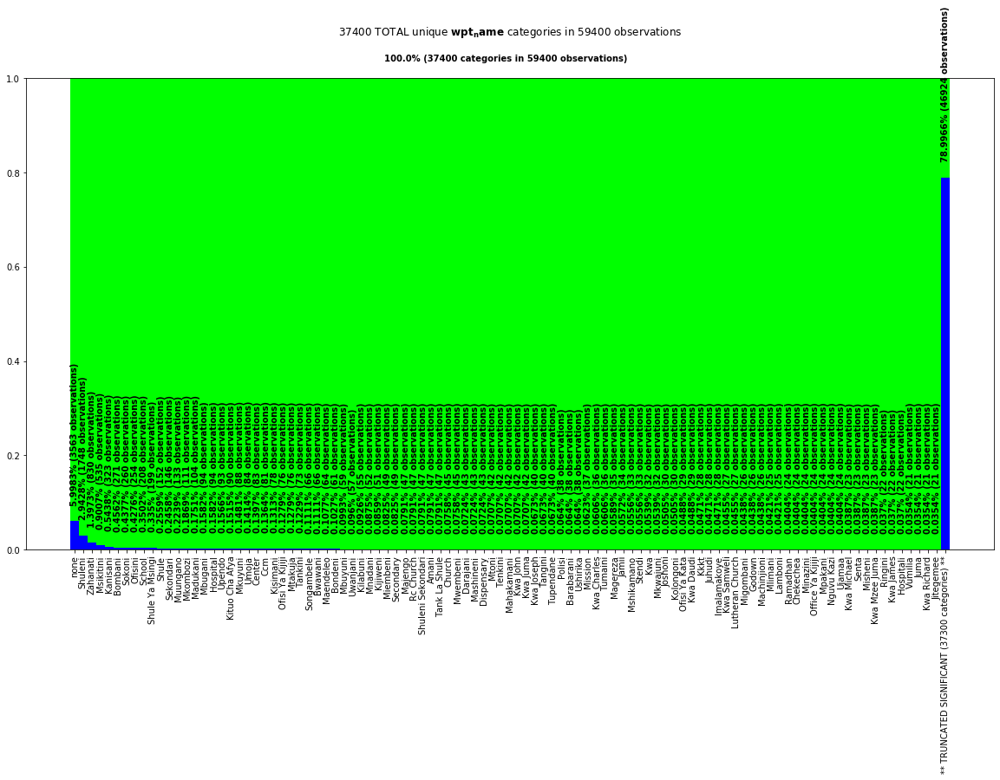

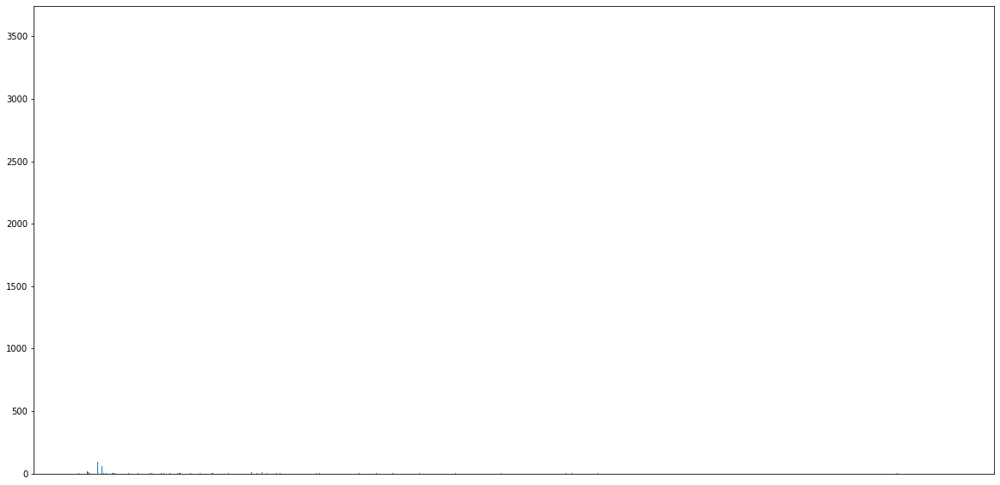

In [91]:
scjpnutils.analyze_distributions(
    X_labeled_clean, 
    'X_labeled', 
    'wpt_name'
);

Again, we'll employ `analyze_non_alphanumeric_strings` to get a feel for "duplication" status.  If we see little duplication or the values appear to truly be unique names, then we should be able to write this feature off as a quasi-identifier.

In [92]:
scjpnutils.analyze_non_alphanumeric_strings(X_labeled_clean[['wpt_name']], 'X_labeled_clean <i>wpt_name</i>');

,feature,n_unique,n_non_alphanumeric_str,non_alphanumeric_str_index
0,wpt_name,37400,33000,"Int64Index([ 3, 5, 8, 9, 11,..."


From the samples above, it seems pretty clear that this feature is indeed a quasi-indentifier.  We will drop it as a non-contributing feature.

In [93]:
dct_non_contrib__wpt_name = DropColumnsTransformer(['wpt_name'])
X_labeled_clean = dct_non_contrib__wpt_name.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['drop non-contributing feature: wpt_name', dct_non_contrib__wpt_name])

Let's move on to feature kind <b>num_private</b>.

<p><br><br>

In [94]:
display_feature_kind('num_private')

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,num_private,int64,65,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14,...",0.001094,99.89,0,0.0,None


#### Feature Analysis: *num_private*

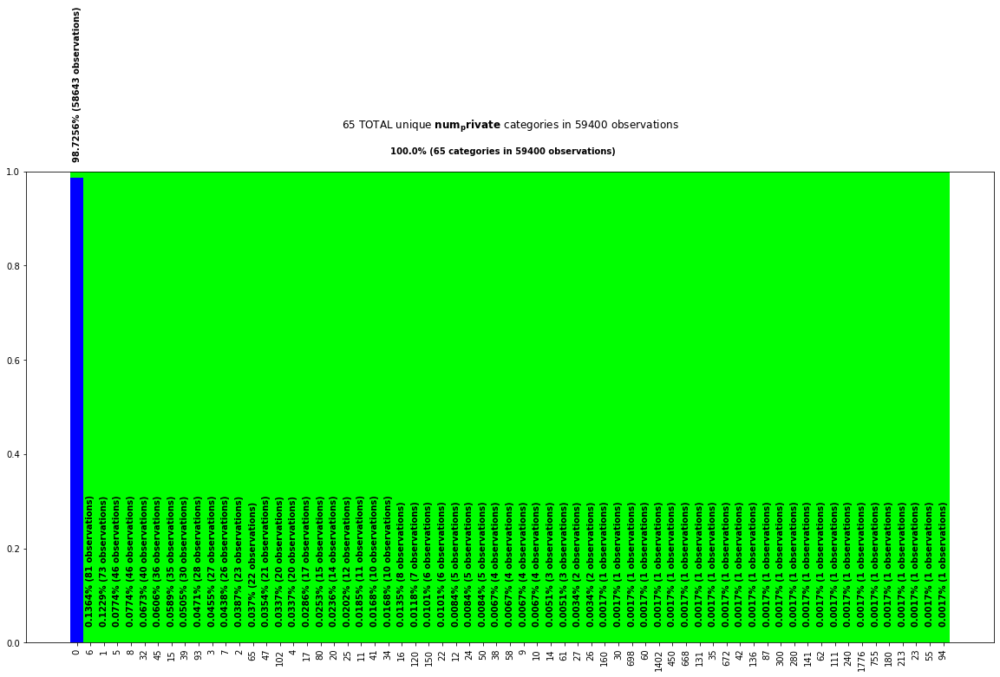

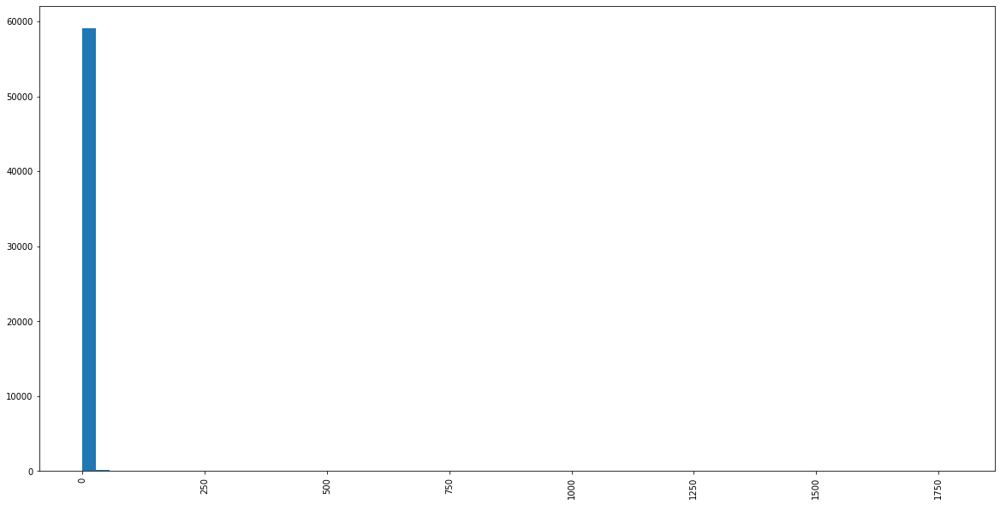

In [95]:
scjpnutils.analyze_distributions(
    X_labeled_clean, 
    'X_labeled', 
    'num_private'
);

The above analysis indicates that 1 single value (0) constitutes more than 98% of the population of labeled observations!  We will <u>drop the <b>num_private</b> feature</u>.

In [96]:
dct_non_contrib__num_private = DropColumnsTransformer(['num_private'])
X_labeled_clean = dct_non_contrib__num_private.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['drop non-contributing feature: num_private', dct_non_contrib__num_private])

Let's move on to feature kind <b>basin</b>.

<p><br><br>

In [97]:
display_feature_kind('basin')

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,basin,object,9,"[Internal, Lake Nyasa, Lake Rukwa, Lake Tangan...",0.000152,99.98,0,0.0,None


#### Feature Analysis: *basin*

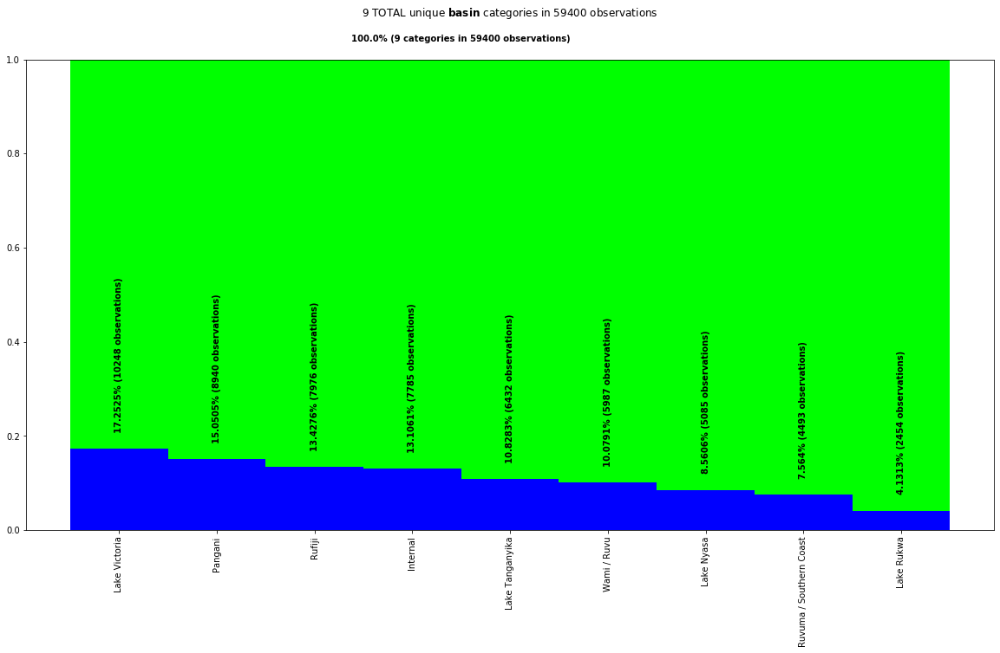

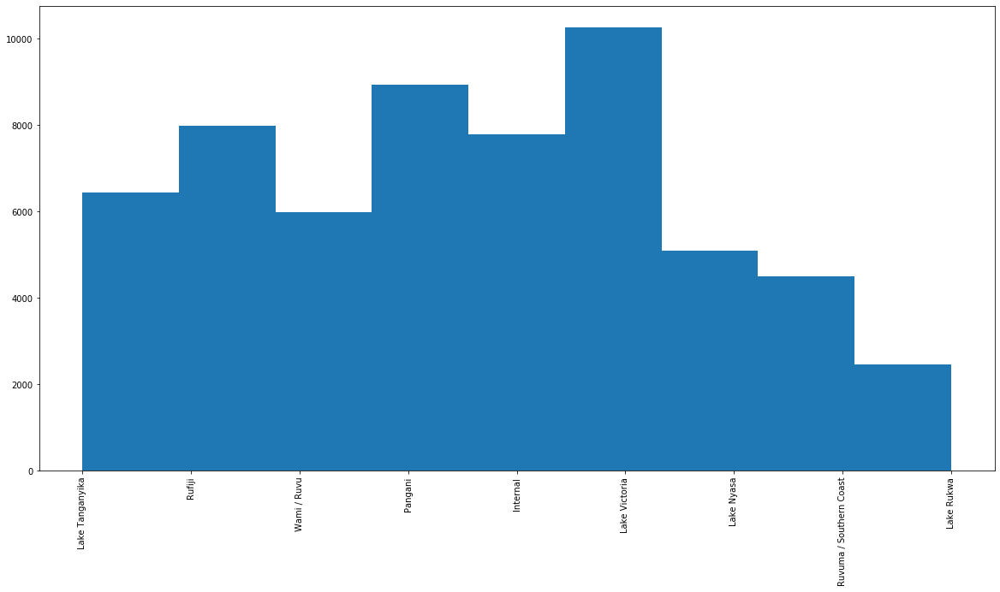

In [98]:
scjpnutils.analyze_distributions(
    X_labeled_clean, 
    'X_labeled', 
    'basin'
);

There is nothing really out of the ordinary here.  Our next steps are to impute lower-case and then Label Encode the above using `LabelEncodingTransformer`.

In [99]:
ft_impute_lcase_basin = FunctionTransformer(lambda X: impute_lcase(X, 'basin'), validate=False)
X_labeled_clean = ft_impute_lcase_basin.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['impute lower case: basin', ft_impute_lcase_basin])

In [100]:
# let_basin = LabelEncodingTransformer(['basin'])
# X_labeled_clean = let_basin.fit_transform(X_labeled_clean)

# # add this step to the pipeline
# pipeline_data_preprocessor.steps.append(['label encode: basin', let_basin])

# display(HTML(f"<h3>X_labeled_clean <i>basin</i> Class-Label Map AFTER Label Encoding:</h3>"))
# let_basin.df_classes

In [101]:
X_labeled_clean, ft_target_encode_basin = target_encode(X_labeled_clean, 'basin')

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['target encode: basin', ft_target_encode_basin])

Let's move on to feature kind <b>geographic_location_coded</b>.

<p><br><br>

In [102]:
display_feature_kind('geographic_location_coded')

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,region_code,int64,27,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",0.000455,99.95,0,0.0,None
1,district_code,int64,20,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 13, 23, 30, 33, 43...",0.000337,99.97,0,0.0,None


#### Feature Analysis: *region_code*

There are no null/missing values.  NICE!

This is clearly a categorical (but not ordinal) variable.  

We remind the reader that since the plan is to classify using Gradient-Boosted trees, we will avoid using One-Hot Encoding.  

So, we should be able to use this feature as is.

But let us continue with analysis to be sure.

Let's have a look at value-counts.

In [103]:
X_labeled_clean.region_code.value_counts()

11    5300
17    5011
12    4639
3     4379
5     4040
18    3324
19    3047
2     3024
16    2816
10    2640
4     2513
1     2201
13    2093
14    1979
20    1969
15    1808
6     1609
21    1583
80    1238
60    1025
90     917
7      805
99     423
9      390
24     326
8      300
40       1
Name: region_code, dtype: int64

Let's have a look at the distribution of "unique" values.  

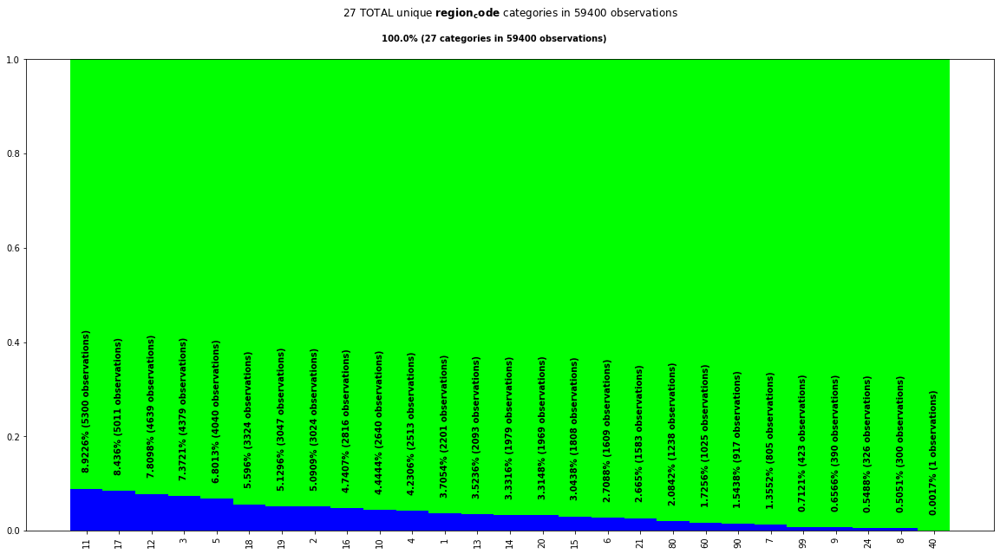

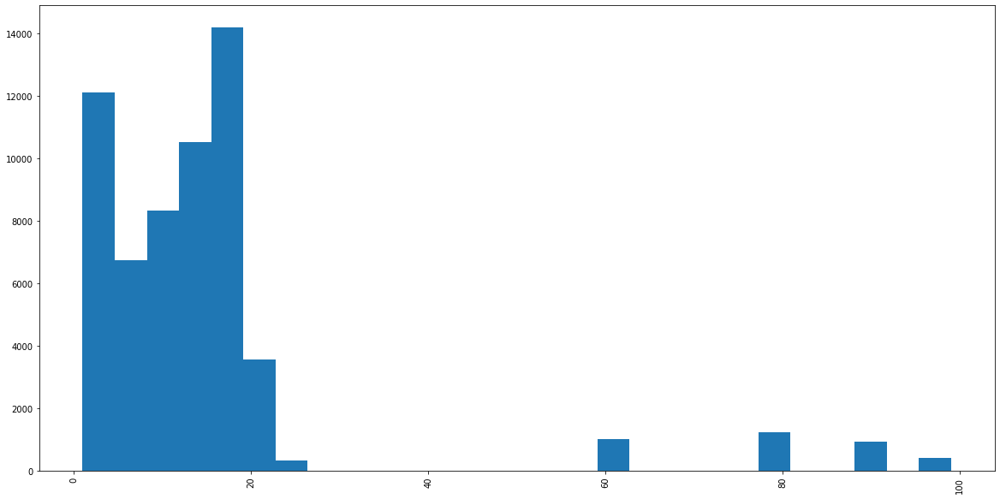

In [104]:
scjpnutils.analyze_distributions(
    X_labeled_clean, 
    'X_labeled_clean', 
    'region_code'
);

In [105]:
X_labeled_clean, ft_target_encode_region_code = target_encode(X_labeled_clean, 'region_code')

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['target encode: region_code', ft_target_encode_region_code])

We see that there are some values that are "under-represented" in the population of observations.  But this should be okay.

Other than that, this feature is good to go.

#### Feature Analysis: *district_code*

As with <b>region_code</b>, <b>district_code</b> has no null/missing values.

This is also clearly a categorical (but not ordinal) variable.  

We should be able to use this feature as is.

Let's have a look at value-counts.

In [106]:
X_labeled_clean.district_code.value_counts()

1     12203
2     11173
3      9998
4      8999
5      4356
6      4074
7      3343
8      1043
30      995
33      874
53      745
43      505
13      391
23      293
63      195
62      109
60       63
0        23
80       12
67        6
Name: district_code, dtype: int64

And its distribution...

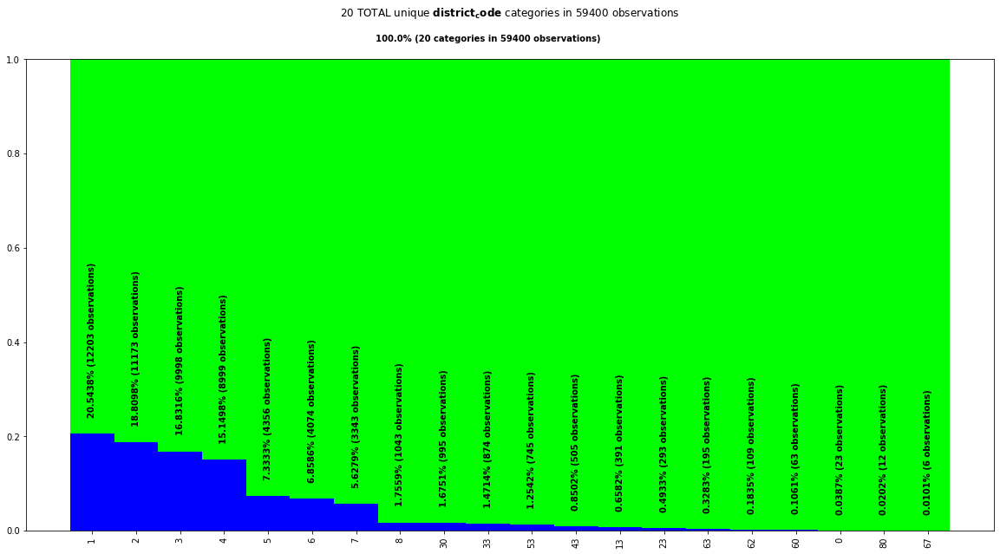

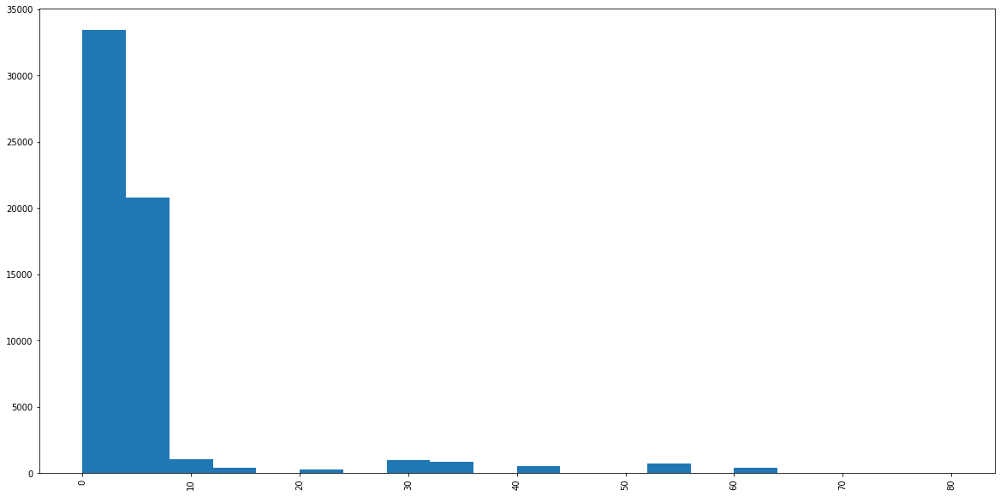

In [107]:
scjpnutils.analyze_distributions(
    X_labeled_clean, 
    'X_labeled_clean', 
    'district_code'
);

In [108]:
X_labeled_clean, ft_target_encode_district_code = target_encode(X_labeled_clean, 'district_code')

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['target encode: district_code', ft_target_encode_district_code])

This feature is good to go.

Let's move on to feature kind <b>geographic_location</b> (not coded).

<p><br><br>

In [109]:
display_feature_kind('geographic_location')

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,subvillage,object,19288,"[##, 'A' Kati, 1, 14Kambalage, 18, 19, 20, 22B...",0.324714,67.53,371,0.006246,"Int64Index([ 18, 136, 412, 481, 1258,..."
1,region,object,21,"[Arusha, Dar es Salaam, Dodoma, Iringa, Kagera...",0.000354,99.96,0,0.000000,None
2,lga,object,125,"[Arusha Rural, Arusha Urban, Babati, Bagamoyo,...",0.002104,99.79,0,0.000000,None
3,ward,object,2092,"[Aghondi, Akheri, Arash, Arri, Arusha Chini, B...",0.035219,96.48,0,0.000000,None


Keying off of the descriptions provided, these features represent, in string (name) format, information we already have encoded by <b>geographic_location_coded</b> <i>kind</i> features.  So we can short-circuit analysis and just remove them as "non-contributing" features.

But we still need to add the steps to drop these features to the `Pipeline`.

In [110]:
dct_non_contrib__geo_loc = DropColumnsTransformer(['region', 'lga', 'ward', 'subvillage'])
X_labeled_clean = dct_non_contrib__geo_loc.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['drop non-contributing features: region, lga, ward, and subvillage', dct_non_contrib__geo_loc])

Let's move on to feature kind <b>population</b>.

<p><br><br>

In [111]:
display_feature_kind('population')

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,population,int64,1049,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",0.01766,98.23,0,0.0,None


#### Feature Analysis: *population*

There are no null/missing values.

It is a categorical (ordinal) variable.  

We should be able to use this feature as is.

Let's have a look at value-counts.

In [112]:
X_labeled_clean.population.value_counts()

0       21381
1        7025
200      1940
150      1892
250      1681
        ...  
3241        1
1960        1
1685        1
2248        1
1439        1
Name: population, Length: 1049, dtype: int64

And its distribution...

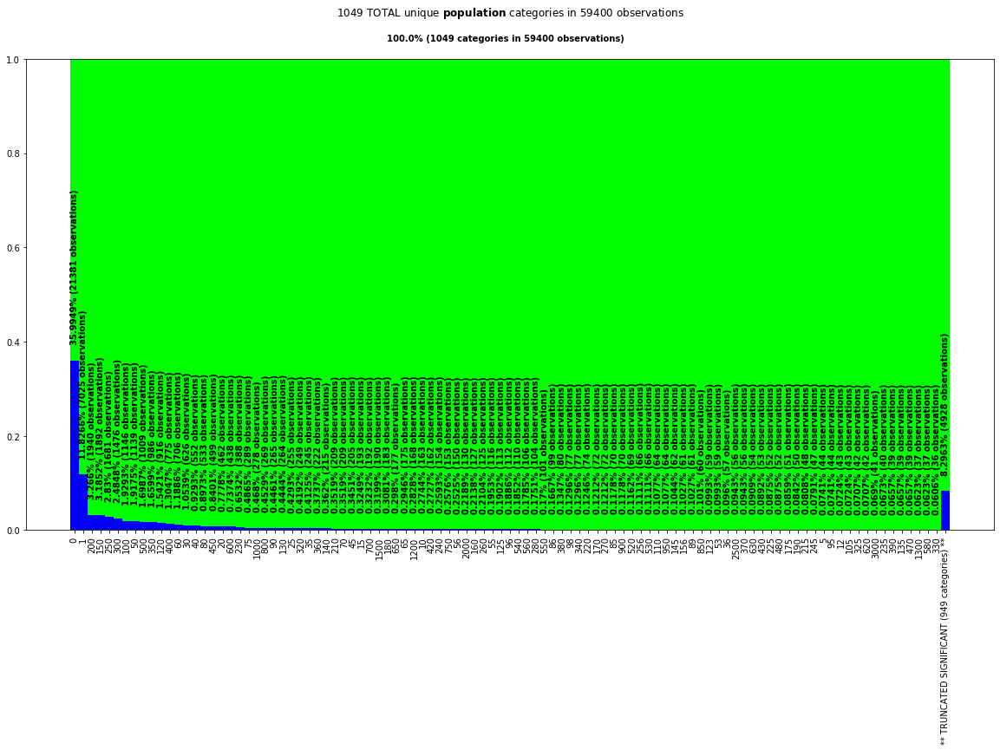

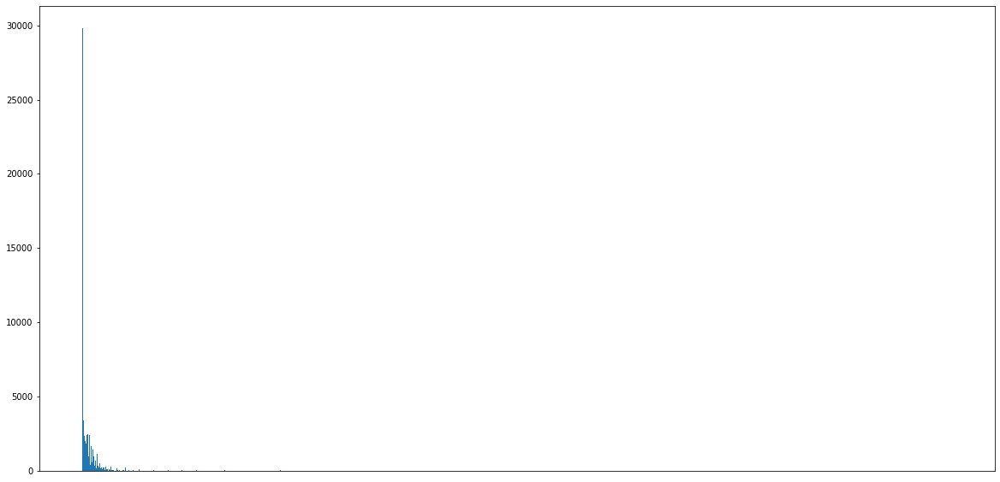

In [113]:
scjpnutils.analyze_distributions(
    X_labeled_clean, 
    'X_labeled_clean', 
    'population'
);

We must consider the possibility that <b>population</b> is continuous and then look at the outliers scenario.

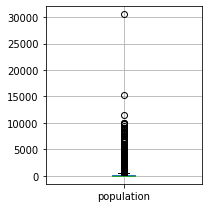

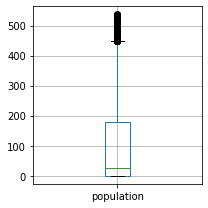

,feature,dtype,q1,q3,IQR_lower_bound,IQR_upper_bound,n_outliers,n_outliers_ratio,outliers_index
0,population,float64,0.0,179.909983,-269.864975,449.774958,2073,0.034899,"Int64Index([ 19, 54, 68, 73, 130,..."


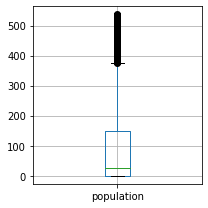

,feature,dtype,q1,q3,IQR_lower_bound,IQR_upper_bound,n_outliers,n_outliers_ratio,outliers_index
0,population,float64,0.0,150.0,-225.0,375.0,3408,0.057374,"Int64Index([ 19, 45, 54, 64, 68,..."


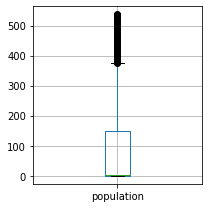

,feature,dtype,q1,q3,IQR_lower_bound,IQR_upper_bound,n_outliers,n_outliers_ratio,outliers_index
0,population,int64,0.0,150.0,-225.0,375.0,3408,0.057374,"Int64Index([ 19, 45, 54, 64, 68,..."


In [114]:
scjpnutils.analyze_outliers_detailed(
    X_labeled_clean, 
    'X_labeled', 
    'population', 
    top_percentile=35, 
    outlier_ratio_reduction_threshold=.10
);

In [115]:
# ft_replace_population_0_with_nan = FunctionTransformer(lambda X: scjpnutils.impute_TO_nan(X, 'population', 0), validate=False)
# X_labeled_clean__population_0_as_nan = ft_replace_population_0_with_nan.fit_transform(X_labeled_clean)

# outliers_index, best_population_outlier_replacement_rules, all_population_outlier_replacement_rules = scjpnutils.analyze_outliers_detailed(
#     X_labeled_clean__population_0_as_nan, 
#     'X_labeled_clean__population_0_as_nan', 
#     'population', 
#     top_percentile=90, 
#     outlier_ratio_reduction_threshold=.10
# )

In [116]:
# X_labeled_clean = ft_replace_population_0_with_nan.fit_transform(X_labeled_clean)
# pipeline_data_preprocessor.steps.append(['replace 0 with NaN: population', ft_replace_population_0_with_nan])

# ft_replace_population_outliers_with_mean = FunctionTransformer(
#     lambda X: scjpnutils.replace_outliers(
#         X, 
#         'population', 
#         X.population.mean()
#     ), 
#     validate=False
# )
# X_labeled_clean = ft_replace_population_outliers_with_mean.fit_transform(X_labeled_clean)
# pipeline_data_preprocessor.steps.append(['impute mean: population', ft_replace_population_outliers_with_mean])

If we assume <b>population</b> is continuous, then no strategy above will remove outliers entirely.  This to me is an indication that this feature is likely not continuous and is, instead, categorical (ordinal) as was said originally.

So we'll just leave this feature as is (no transformations).

Let's move on to feature kind <b>public_meeting</b>.

<p><br><br>

In [117]:
display_feature_kind('public_meeting')

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,public_meeting,object,3,"[False, True, nan]",0.000051,99.99,3334,0.056128,"Int64Index([ 0, 27, 45, 79, 122,..."


#### Feature Analysis: *public_meeting*

There are null/missing values we must deal with.  We will replace null/missing values with `False`.

Doing this will also implicitly convert it to its proper type (`bool`).

In [118]:
# val counts before replacing nulls
X_labeled_clean.public_meeting.value_counts(normalize=True)

True     0.909838
False    0.090162
Name: public_meeting, dtype: float64

In [119]:
missing_bool_value_replacement = False

replace_null_rules = {'public_meeting': [{'missing_values': np.nan, 'strategy': 'constant', 'fill_value': missing_bool_value_replacement}]}
svt_null_public_meeting = SimpleValueTransformer(replace_null_rules)
X_labeled_clean = svt_null_public_meeting.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['impute \'none\' for missing values: public_meeting', svt_null_public_meeting])

In [120]:
X_labeled_clean.public_meeting.value_counts(normalize=True)

True     0.858771
False    0.141229
Name: public_meeting, dtype: float64

Let's move on to feature kind <b>recorded_by</b>.

<p><br><br>

In [121]:
display_feature_kind('recorded_by')

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,recorded_by,object,1,[GeoData Consultants Ltd],0.000017,100.0,0,0.0,None


#### Feature Analysis: *recorded_by*

This feature is obviously non-contributing since it contains only 1 unique value.

We will drop it.

In [122]:
dct_non_contrib__recorded_by = DropColumnsTransformer(['recorded_by'])
X_labeled_clean = dct_non_contrib__recorded_by.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['drop non-contributing features: recorded_by', dct_non_contrib__recorded_by])

Let's move on to feature kind <b>wpt_operator</b>.

<p><br><br>

In [123]:
display_feature_kind('wpt_operator')

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,scheme_management,object,13,"[Company, None, Other, Parastatal, Private ope...",0.000219,99.98,3877,0.065269,"Int64Index([ 1, 15, 34, 79, 81,..."
1,scheme_name,object,2697,"[14 Kambarage, A, ADP, ADP Simbo, ADP Simbu, A...",0.045404,95.46,28166,0.474175,"Int64Index([ 0, 1, 4, 5, 6,..."


#### Feature Analysis: *scheme_management*

We need to deal with its null/missing values.

As usual, we'll first imput lower-case and then check for existing "none"-type categories.

In [124]:
ft_impute_lcase_scheme_management = FunctionTransformer(lambda X: impute_lcase(X, 'scheme_management'), validate=False)
X_labeled_clean = ft_impute_lcase_scheme_management.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['impute lower case: scheme_management', ft_impute_lcase_scheme_management])

# finally, check to see if there is an appropriate existing value in X_labeled.funder to indicate null - e.g. 'none', 'unknown', 'not known', etc.
scjpnutils.index_of_values(X_labeled_clean, 'X_labeled', 'scheme_management', ['none', 'unknown', 'not known'])

(array([52611]), array(['none'], dtype=object))

So we will not need to create a new category to replace null/missing values...

In [125]:
replace_null_rules = {'scheme_management': [{'missing_values': np.nan, 'strategy': 'constant', 'fill_value': missing_string_value_replacement}]}
svt_null_scheme_management = SimpleValueTransformer(replace_null_rules)
X_labeled_clean = svt_null_scheme_management.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['impute \'none\' for missing values: scheme_management', svt_null_scheme_management])

And now its distribution...

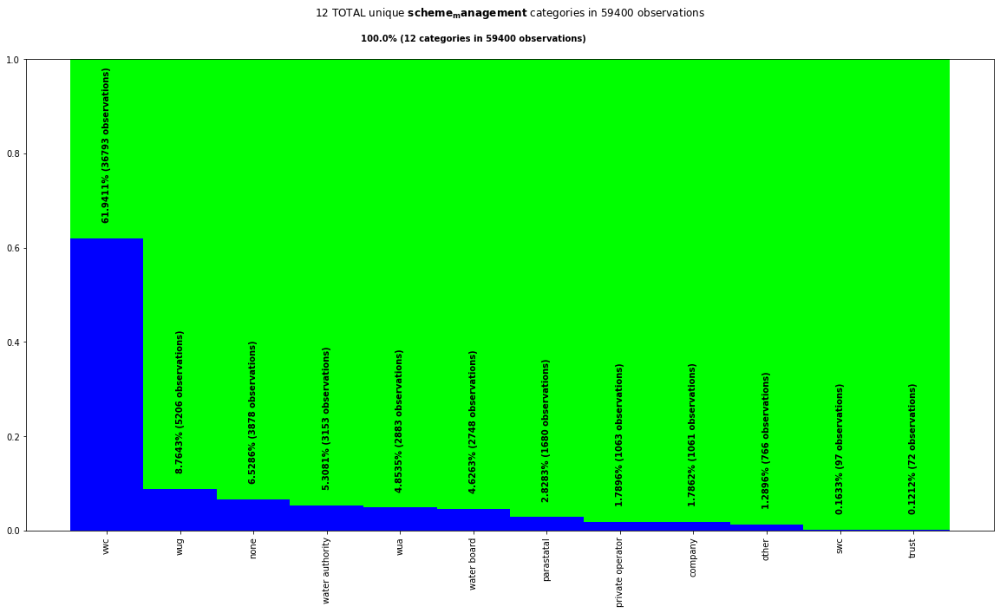

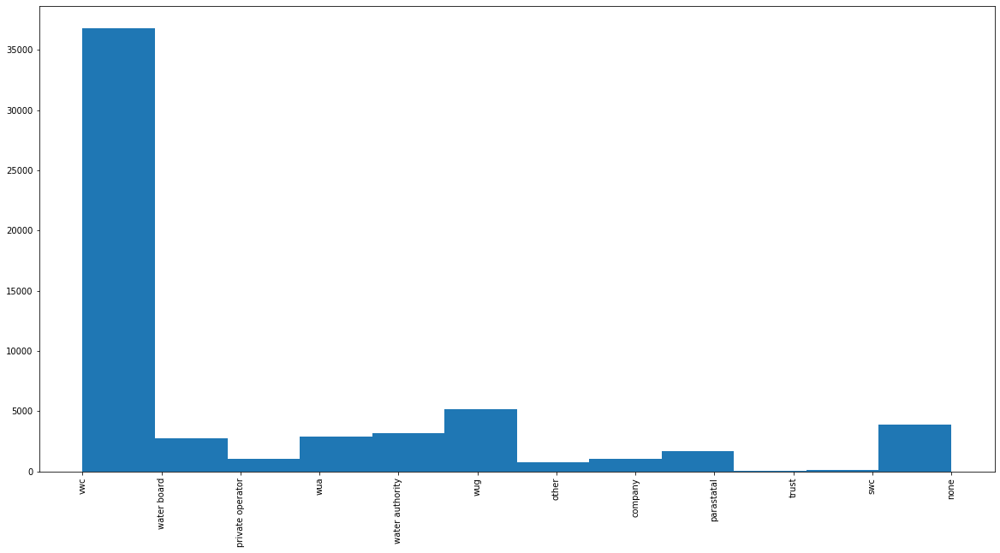

In [126]:
scjpnutils.analyze_distributions(
    X_labeled_clean, 
    'X_labeled_clean', 
    'scheme_management'
);

This looks good.  So we can now label encode it...

In [127]:
# let_scheme_management = LabelEncodingTransformer(['scheme_management'])
# X_labeled_clean = let_scheme_management.fit_transform(X_labeled_clean)

# # add this step to the pipeline
# pipeline_data_preprocessor.steps.append(['label encode: scheme_management', let_scheme_management])

# display(HTML(f"<h3>X_labeled_clean <i>scheme_management</i> Class-Label Map AFTER Label Encoding:</h3>"))
# let_scheme_management.df_classes

In [128]:
X_labeled_clean, ft_target_encode_scheme_management = target_encode(X_labeled_clean, 'scheme_management')

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['target encode: scheme_management', ft_target_encode_scheme_management])

#### Feature Analysis: *scheme_name*

We need to deal with its null/missing values.

As usual, we'll first imput lower-case and then check for existing "none"-type categories.

In [129]:
ft_impute_lcase_scheme_name = FunctionTransformer(lambda X: impute_lcase(X, 'scheme_name'), validate=False)
X_labeled_clean = ft_impute_lcase_scheme_name.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['impute lower case: scheme_name', ft_impute_lcase_scheme_name])

# finally, check to see if there is an appropriate existing value in X_labeled.funder to indicate null - e.g. 'none', 'unknown', 'not known', etc.
scjpnutils.index_of_values(X_labeled_clean, 'X_labeled', 'scheme_name', ['none', 'unknown', 'not known'])

(array([   33,    62,   103,   147,   199,   200,   229,   259,   274,
          275,   311,   316,   324,   442,   477,   482,   507,   544,
          603,   610,   637,   662,   678,   712,   754,   815,   877,
          896,   897,  1010,  1026,  1037,  1064,  1147,  1180,  1192,
         1214,  1224,  1284,  1367,  1380,  1384,  1385,  1403,  1429,
         1441,  1503,  1537,  1585,  1590,  1700,  1714,  1717,  1772,
         1780,  1788,  1794,  1807,  1836,  1848,  1961,  1996,  2040,
         2098,  2250,  2277,  2288,  2307,  2321,  2325,  2419,  2457,
         2491,  2522,  2525,  2595,  2615,  2670,  2739,  2822,  2836,
         2837,  2860,  2874,  3010,  3103,  3186,  3204,  3236,  3250,
         3272,  3414,  3500,  3540,  3578,  3667,  3707,  3720,  3813,
         3826,  3863,  3967,  4026,  4047,  4133,  4203,  4265,  4307,
         4311,  4321,  4337,  4360,  4433,  4506,  4542,  4554,  4564,
         4568,  4605,  4830,  4879,  4894,  4903,  5086,  5101,  5107,
      

We will replace null/missing values with "none".

We will replace "not known" with "unknown".

In [130]:
replace_null_rules = {'scheme_name': [{'missing_values': np.nan, 'strategy': 'constant', 'fill_value': missing_string_value_replacement}]}
svt_null_scheme_name = SimpleValueTransformer(replace_null_rules)
X_labeled_clean = svt_null_scheme_name.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['impute \'none\' for missing values: scheme_name', svt_null_scheme_name])

In [131]:
replace_same_concept_words = {'scheme_name': [{'missing_values': "not known", 'strategy': 'constant', 'fill_value': "unknown"}]}
svt_not_known_scheme_name = SimpleValueTransformer(replace_same_concept_words)
X_labeled_clean = svt_not_known_scheme_name.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['replace same concept words: scheme_name', svt_not_known_scheme_name])

And now the distribution...

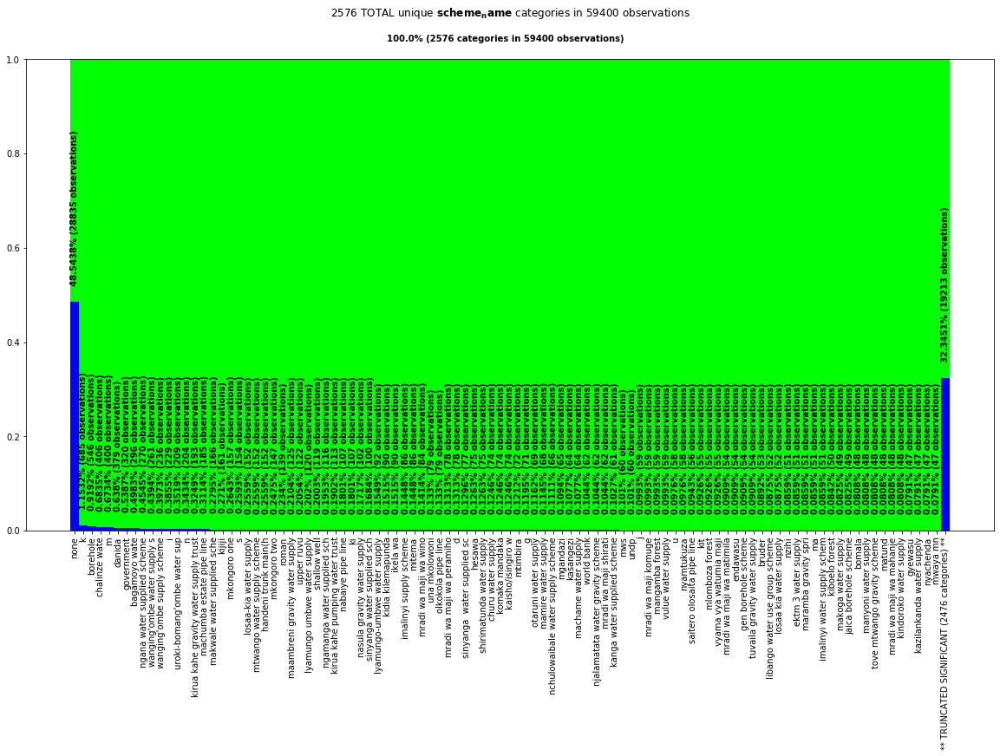

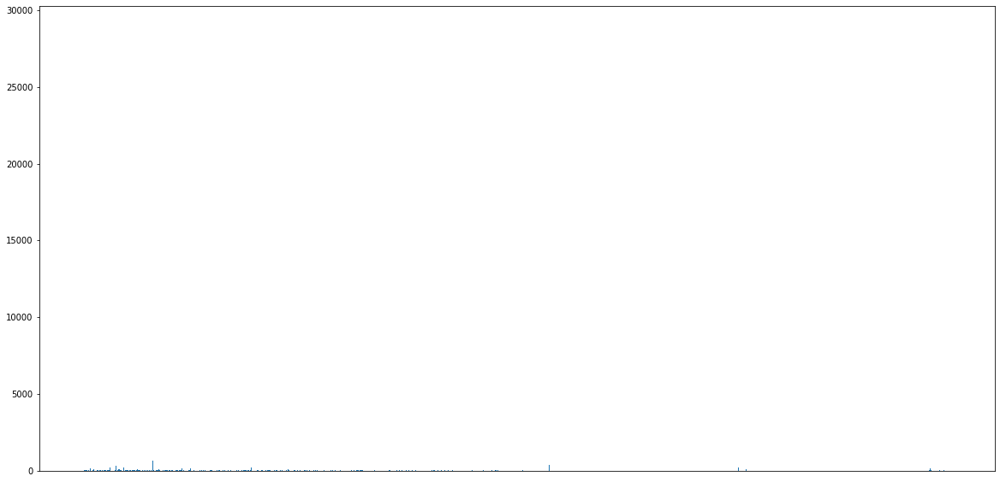

In [132]:
scjpnutils.analyze_distributions(
    X_labeled_clean, 
    'X_labeled_clean', 
    'scheme_name'
);

We will again employ the `tfidf_kmeans_classify_feature` function to classify <b>scheme_name</b>.

But before we do so, let's see how bad duplication is so we are sure it is indeed needed.

In [133]:
scjpnutils.analyze_non_alphanumeric_strings(X_labeled_clean[['scheme_name']], 'X_labeled_clean <i>scheme_name</i>');

,feature,n_unique,n_non_alphanumeric_str,non_alphanumeric_str_index
0,scheme_name,2576,18482,"Int64Index([ 3, 11, 16, 17, 19,..."


YIKES!  There appears to be much duplication.

In [134]:
# ft_tfidf_kmeans_classify_scheme_name = FunctionTransformer(
#     lambda X: scjpnsubmodels.tfidf_kmeans_classify_feature(
#         X, 
#         '', 
#         'scheme_name', 
#         verbose=0
#     )[0], 
#     validate=False
# )
# X_labeled_clean = ft_tfidf_kmeans_classify_scheme_name.fit_transform(X_labeled_clean)

# # add this step to the pipeline
# pipeline_data_preprocessor.steps.append(['tfidf-kmeans-classify: scheme_name', ft_tfidf_kmeans_classify_scheme_name])

In [135]:
# dct_scheme_name = DropColumnsTransformer(['scheme_name'])
# X_labeled_clean = dct_scheme_name.fit_transform(X_labeled_clean)

# # add this step to the pipeline
# pipeline_data_preprocessor.steps.append(['drop potential overfit columns: scheme_name', dct_scheme_name])

In [136]:
X_labeled_clean, ft_target_encode_scheme_name = target_encode(X_labeled_clean, 'scheme_name')

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['target encode: scheme_name', ft_target_encode_scheme_name])

Let's move on to feature kind <b>permit</b>.

<p><br><br>

In [137]:
display_feature_kind('permit')

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,permit,object,3,"[False, True, nan]",0.000051,99.99,3056,0.051448,"Int64Index([ 159, 201, 523, 860, 1013,..."


#### Feature Analysis: *permit*

There are null/missing values we must deal with.  We will replace null/missing values with `False`.

Doing this will also implicitly convert it to its proper type (`bool`).

In [138]:
# val counts before replacing nulls
X_labeled_clean.permit.value_counts(normalize=True)

True     0.68955
False    0.31045
Name: permit, dtype: float64

In [139]:
replace_null_rules = {'permit': [{'missing_values': np.nan, 'strategy': 'constant', 'fill_value': missing_bool_value_replacement}]}
svt_null_permit = SimpleValueTransformer(replace_null_rules)
X_labeled_clean = svt_null_permit.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['impute \'none\' for missing values: permit', svt_null_permit])

In [140]:
X_labeled_clean.permit.value_counts(normalize=True)

True     0.654074
False    0.345926
Name: permit, dtype: float64

Let's move on to feature kind <b>wpt_extraction_type_class</b>.

<p><br><br>

In [141]:
display_feature_kind('wpt_extraction_type_class')

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,extraction_type,object,18,"[afridev, cemo, climax, gravity, india mark ii...",0.000303,99.97,0,0.0,None
1,extraction_type_group,object,13,"[afridev, gravity, india mark ii, india mark i...",0.000219,99.98,0,0.0,None
2,extraction_type_class,object,7,"[gravity, handpump, motorpump, other, rope pum...",0.000118,99.99,0,0.0,None


These are relatively low cardinality categorical features that seem to have some overlap.  Let's formalize this overlap-analysis.

In [142]:
scjpnutils.analyze_overlap(
    'wpt_extraction_type_class', 
    predictors_kind_classification['wpt_extraction_type_class']['features'], 
    'X_labeled_clean', 
    X_labeled_clean,
    suppress_value_analysis_output=True
)

,extraction_type,extraction_type_class
id,,
2,mono,motorpump
8,mono,motorpump
9,mono,motorpump
18,mono,motorpump
19,mono,motorpump
21,mono,motorpump
36,mono,motorpump
67,nira/tanira,handpump
94,mono,motorpump


,extraction_type_group,extraction_type_class
id,,
2,mono,motorpump
8,mono,motorpump
9,mono,motorpump
18,mono,motorpump
19,mono,motorpump
21,mono,motorpump
36,mono,motorpump
67,nira/tanira,handpump
94,mono,motorpump


,extraction_type,extraction_type_group
id,,
112,ksb,submersible
209,cemo,other motorpump
218,ksb,submersible
227,windmill,wind-powered
262,ksb,submersible
274,ksb,submersible
398,ksb,submersible
476,ksb,submersible
559,ksb,submersible


We will settle on keeping <b>extraction_type</b> since it basically contains the other two features and has more information.

First, we will label encode <b>extraction_type</b>.

In [143]:
# let_extraction_type = LabelEncodingTransformer(['extraction_type'])
# X_labeled_clean = let_extraction_type.fit_transform(X_labeled_clean)

# # add this step to the pipeline
# pipeline_data_preprocessor.steps.append(['label encode: extraction_type', let_extraction_type])

# display(HTML(f"<h3>X_labeled_clean <i>extraction_type</i> Class-Label Map AFTER Label Encoding:</h3>"))
# let_extraction_type.df_classes

In [144]:
X_labeled_clean, ft_target_encode_extraction_type = target_encode(X_labeled_clean, 'extraction_type')

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['target encode: extraction_type', ft_target_encode_extraction_type])

And now drop the other two as non-contributing features...

In [145]:
dct_non_contrib__wpt_extraction_type_class = DropColumnsTransformer(['extraction_type_group', 'extraction_type_class'])
X_labeled_clean = dct_non_contrib__wpt_extraction_type_class.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['drop non-contributing feature: extraction_type_group, extraction_type_class', dct_non_contrib__wpt_extraction_type_class])

Let's move on to feature kind <b>wpt_management</b>.

<p><br><br>

In [146]:
display_feature_kind('wpt_management')

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,management,object,12,"[company, other, other - school, parastatal, p...",0.000202,99.98,0,0.0,None
1,management_group,object,5,"[commercial, other, parastatal, unknown, user-...",0.000084,99.99,0,0.0,None


Again, these relatively low cardinality categorical features seem to have some overlap.

In [147]:
scjpnutils.analyze_overlap(
    'wpt_management', 
    predictors_kind_classification['wpt_management']['features'], 
    'X_labeled_clean', 
    X_labeled_clean,
    suppress_value_analysis_output=True
)

,management,management_group
id,,
2,vwc,user-group
3,water board,user-group
7,vwc,user-group
8,private operator,commercial
9,vwc,user-group
11,private operator,commercial
16,vwc,user-group
17,vwc,user-group
18,vwc,user-group


It turns out the population does not actually manifest much overlap.  But it is clear that some information is duplicated by these categorites.

We will therefore settle on keeping <b>management</b> since it contains more information.

First, we need to label encode <b>management</b>.

In [148]:
# let_management = LabelEncodingTransformer(['management'])
# X_labeled_clean = let_management.fit_transform(X_labeled_clean)

# # add this step to the pipeline
# pipeline_data_preprocessor.steps.append(['label encode: management', let_management])

# display(HTML(f"<h3>X_labeled_clean <i>management</i> Class-Label Map AFTER Label Encoding:</h3>"))
# let_management.df_classes

In [149]:
X_labeled_clean, ft_target_encode_management = target_encode(X_labeled_clean, 'management')

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['target encode: management', ft_target_encode_management])

And now drop the other one as a non-contributing feature...

In [150]:
dct_non_contrib__wpt_management = DropColumnsTransformer(['management_group'])
X_labeled_clean = dct_non_contrib__wpt_management.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['drop non-contributing feature: management_group', dct_non_contrib__wpt_management])

Let's move on to feature kind <b>payment_frequency_class</b>.

<p><br><br>

In [151]:
display_feature_kind('payment_frequency_class')

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,payment,object,7,"[never pay, other, pay annually, pay monthly, ...",0.000118,99.99,0,0.0,None
1,payment_type,object,7,"[annually, monthly, never pay, on failure, oth...",0.000118,99.99,0,0.0,None


These two features obviously overlap but let's formalize this.

In [152]:
scjpnutils.analyze_overlap(
    'payment_frequency_class', 
    predictors_kind_classification['payment_frequency_class']['features'], 
    'X_labeled_clean', 
    X_labeled_clean,
    suppress_value_analysis_output=True
)

,payment,payment_type
id,,
2,pay per bucket,per bucket
3,pay per bucket,per bucket
8,pay per bucket,per bucket
11,pay per bucket,per bucket
16,pay when scheme fails,on failure
18,pay per bucket,per bucket
19,pay per bucket,per bucket
20,pay monthly,monthly
30,pay when scheme fails,on failure


Since these are basically semantically identical, we will go with the less wordy one: <b>payment_type</b>.

Let's label encode it first.

In [153]:
# let_payment_type = LabelEncodingTransformer(['payment_type'])
# X_labeled_clean = let_payment_type.fit_transform(X_labeled_clean)

# # add this step to the pipeline
# pipeline_data_preprocessor.steps.append(['label encode: payment_type', let_payment_type])

# display(HTML(f"<h3>X_labeled_clean <i>payment_type</i> Class-Label Map AFTER Label Encoding:</h3>"))
# let_payment_type.df_classes

In [154]:
X_labeled_clean, ft_target_encode_payment_type = target_encode(X_labeled_clean, 'payment_type')

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['target encode: payment_type', ft_target_encode_payment_type])

And now drop the other one as a non-contributing feature...

In [155]:
dct_non_contrib__payment_frequency_class = DropColumnsTransformer(['payment'])
X_labeled_clean = dct_non_contrib__payment_frequency_class.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['drop non-contributing feature: payment', dct_non_contrib__payment_frequency_class])

Let's move on to feature kind <b>water_quality_class</b>.

<p><br><br>

In [156]:
display_feature_kind('water_quality_class')

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,water_quality,object,8,"[coloured, fluoride, fluoride abandoned, milky...",0.000135,99.99,0,0.0,None
1,quality_group,object,6,"[colored, fluoride, good, milky, salty, unknown]",0.000101,99.99,0,0.0,None


Again, we seem to have overlap...

In [157]:
scjpnutils.analyze_overlap(
    'water_quality_class', 
    predictors_kind_classification['water_quality_class']['features'], 
    'X_labeled_clean', 
    X_labeled_clean,
    suppress_value_analysis_output=True
)

,water_quality,quality_group
id,,
2,soft,good
3,soft,good
8,soft,good
9,soft,good
16,soft,good
17,soft,good
19,soft,good
20,soft,good
21,soft,good


We will go with <b>water_quality</b> since it contains more information.  We must note that "soft" is equivalent to "good".  We don't really need to go as far as replacing this value, however, since we will be label-encoding it anyway.

In [158]:
# let_water_quality = LabelEncodingTransformer(['water_quality'])
# X_labeled_clean = let_water_quality.fit_transform(X_labeled_clean)

# # add this step to the pipeline
# pipeline_data_preprocessor.steps.append(['label encode: water_quality', let_water_quality])

# display(HTML(f"<h3>X_labeled_clean <i>water_quality</i> Class-Label Map AFTER Label Encoding:</h3>"))
# let_water_quality.df_classes

In [159]:
X_labeled_clean, ft_target_encode_water_quality = target_encode(X_labeled_clean, 'water_quality')

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['target encode: water_quality', ft_target_encode_water_quality])

And now drop the other one as a non-contributing feature...

In [160]:
dct_non_contrib__water_quality_class = DropColumnsTransformer(['quality_group'])
X_labeled_clean = dct_non_contrib__water_quality_class.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['drop non-contributing feature: quality_group', dct_non_contrib__water_quality_class])

Let's move on to feature kind <b>water_quantity_class</b>.

<p><br><br>

In [161]:
display_feature_kind('water_quantity_class')

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,quantity,object,5,"[dry, enough, insufficient, seasonal, unknown]",0.000084,99.99,0,0.0,None
1,quantity_group,object,5,"[dry, enough, insufficient, seasonal, unknown]",0.000084,99.99,0,0.0,None


Wow!  Do we even need to bother checking overlap officially?

In [162]:
scjpnutils.analyze_overlap(
    'water_quantity_class', 
    predictors_kind_classification['water_quantity_class']['features'], 
    'X_labeled_clean', 
    X_labeled_clean,
    suppress_value_analysis_output=True
)

,quantity,quantity_group
id,,


So they are identical in every observation!

We will go with <b>quantity</b> based solely on its shorter name.

Of course, we need to label-encode it first.

In [163]:
# let_quantity = LabelEncodingTransformer(['quantity'])
# X_labeled_clean = let_quantity.fit_transform(X_labeled_clean)

# # add this step to the pipeline
# pipeline_data_preprocessor.steps.append(['label encode: quantity', let_quantity])

# display(HTML(f"<h3>X_labeled_clean <i>quantity</i> Class-Label Map AFTER Label Encoding:</h3>"))
# let_quantity.df_classes

In [164]:
X_labeled_clean, ft_target_encode_quantity = target_encode(X_labeled_clean, 'quantity')

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['target encode: quantity', ft_target_encode_quantity])

And now drop the other one as a non-contributing feature...

In [165]:
dct_non_contrib__water_quantity_class = DropColumnsTransformer(['quantity_group'])
X_labeled_clean = dct_non_contrib__water_quantity_class.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['drop non-contributing feature: quantity_group', dct_non_contrib__water_quantity_class])

Let's move on to feature kind <b>water_source_type_class</b>.

<p><br><br>

In [166]:
display_feature_kind('water_source_type_class')

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,source,object,10,"[dam, hand dtw, lake, machine dbh, other, rain...",0.000168,99.98,0,0.0,None
1,source_type,object,7,"[borehole, dam, other, rainwater harvesting, r...",0.000118,99.99,0,0.0,None
2,source_class,object,3,"[groundwater, surface, unknown]",0.000051,99.99,0,0.0,None


The overlapping situation is now so obvious here.  Let's formalize it.

In [167]:
scjpnutils.analyze_overlap(
    'water_source_type_class', 
    predictors_kind_classification['water_source_type_class']['features'], 
    'X_labeled_clean', 
    X_labeled_clean,
    suppress_value_analysis_output=True
)

,source,source_type
id,,
2,machine dbh,borehole
8,machine dbh,borehole
9,machine dbh,borehole
11,machine dbh,borehole
18,machine dbh,borehole
19,machine dbh,borehole
20,river,river/lake
21,machine dbh,borehole
30,river,river/lake


,source,source_class
id,,
2,machine dbh,groundwater
3,spring,groundwater
7,spring,groundwater
8,machine dbh,groundwater
9,machine dbh,groundwater
11,machine dbh,groundwater
16,spring,groundwater
17,spring,groundwater
18,machine dbh,groundwater


,source_type,source_class
id,,
2,borehole,groundwater
3,spring,groundwater
7,spring,groundwater
8,borehole,groundwater
9,borehole,groundwater
11,borehole,groundwater
16,spring,groundwater
17,spring,groundwater
18,borehole,groundwater


<b>source</b> seems to contain the most information so we will go with that.

As usual, it needs to be label-encoded.

In [168]:
# let_source = LabelEncodingTransformer(['source'])
# X_labeled_clean = let_source.fit_transform(X_labeled_clean)

# # add this step to the pipeline
# pipeline_data_preprocessor.steps.append(['label encode: source', let_source])

# display(HTML(f"<h3>X_labeled_clean <i>source</i> Class-Label Map AFTER Label Encoding:</h3>"))
# let_source.df_classes

In [169]:
X_labeled_clean, ft_target_encode_source = target_encode(X_labeled_clean, 'source')

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['target encode: source', ft_target_encode_source])

Drop the other non-contributing features...

In [170]:
dct_non_contrib__water_source_type_class = DropColumnsTransformer(['source_type', 'source_class'])
X_labeled_clean = dct_non_contrib__water_source_type_class.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['drop non-contributing feature: source_type, source_class', dct_non_contrib__water_source_type_class])

Let's move on to the FINAL feature kind <b>wpt_type_class</b>.

<p><br><br>

In [171]:
display_feature_kind('wpt_type_class')

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,waterpoint_type,object,7,"[cattle trough, communal standpipe, communal s...",0.000118,99.99,0,0.0,None
1,waterpoint_type_group,object,6,"[cattle trough, communal standpipe, dam, hand ...",0.000101,99.99,0,0.0,None


Obviously there is some overlap againn.

In [172]:
scjpnutils.analyze_overlap(
    'wpt_type_class', 
    predictors_kind_classification['wpt_type_class']['features'], 
    'X_labeled_clean', 
    X_labeled_clean,
    suppress_value_analysis_output=True
)

,waterpoint_type,waterpoint_type_group
id,,
2,communal standpipe multiple,communal standpipe
8,communal standpipe multiple,communal standpipe
9,communal standpipe multiple,communal standpipe
18,communal standpipe multiple,communal standpipe
19,communal standpipe multiple,communal standpipe
20,communal standpipe multiple,communal standpipe
21,communal standpipe multiple,communal standpipe
36,communal standpipe multiple,communal standpipe
43,communal standpipe multiple,communal standpipe


Again, we will go with the feature that contains more information: <b>waterpoint_type</b>.

It must be label-encoded.

In [173]:
# let_waterpoint_type = LabelEncodingTransformer(['waterpoint_type'])
# X_labeled_clean = let_waterpoint_type.fit_transform(X_labeled_clean)

# # add this step to the pipeline
# pipeline_data_preprocessor.steps.append(['label encode: waterpoint_type', let_waterpoint_type])

# display(HTML(f"<h3>X_labeled_clean <i>waterpoint_type</i> Class-Label Map AFTER Label Encoding:</h3>"))
# let_waterpoint_type.df_classes

In [174]:
X_labeled_clean, ft_target_encode_waterpoint_type = target_encode(X_labeled_clean, 'waterpoint_type')

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['target encode: waterpoint_type', ft_target_encode_waterpoint_type])

Drop the other non-contributing feature...

In [175]:
dct_non_contrib__wpt_type_class = DropColumnsTransformer(['waterpoint_type_group'])
X_labeled_clean = dct_non_contrib__wpt_type_class.fit_transform(X_labeled_clean)

# add this step to the pipeline
pipeline_data_preprocessor.steps.append(['drop non-contributing feature: waterpoint_type_group', dct_non_contrib__wpt_type_class])

<p><br><br>

## Drop "Override-Drop" Features (specified in config)

In [176]:
if 'override_drop_feats' in eda_config and len(eda_config['override_drop_feats']) > 0:
    dct_override_drop = DropColumnsTransformer(eda_config['override_drop_feats'])
    X_labeled_clean = dct_override_drop.fit_transform(X_labeled_clean)

    # add this step to the pipeline
    pipeline_data_preprocessor.steps.append([f"override-drop features: {eda_config['override_drop_feats']}", dct_override_drop])

<p><br><br>

# Final Predictors

And that's it!  This leaves us with our final labeled data set.

Let's have a look at our predictors as they currently stand.

In [177]:
scjpnutils.analyze_values(X_labeled_clean, 'X_labeled_clean');

,feature,dtype,n_unique,unique_vals,n_unique_ratio,p_cat,n_null,n_null_ratio,null_index
0,amount_tsh,float64,98,"[0.0, 10.0, 30.0, 50.0, 250.0, 1000.0, 100.0, ...",0.001650,99.84,0,0.000000,None
1,funder,float64,666,"[1.0068493150684932, 0.2348111658456486, 0.982...",0.011212,98.88,974,0.016397,"Int64Index([ 11, 237, 481, 553, 694,..."
2,gps_height,int64,2428,"[0, 1639, 64, 1014, 1606, 226, 1257, 209, 949,...",0.040875,95.91,0,0.000000,None
3,installer,float64,605,"[1.1355932203389831, 0.2348111658456486, 1.054...",0.010185,98.98,974,0.016397,"Int64Index([ 11, 179, 237, 502, 692,..."
4,longitude,float64,57516,"[36.11505595, 37.14743219, 36.31361889, 35.939...",0.968283,3.17,0,0.000000,None
5,latitude,float64,57517,"[-6.27926803, -3.18755455, -6.71925716, -6.014...",0.968300,3.17,0,0.000000,None
6,basin,float64,27,"[0.9076177748078851, 0.7449379125181788, 0.674...",0.000455,99.95,0,0.000000,None
7,region_code,float64,79,"[0.9886363636363636, 0.7208771128369118, 0.987...",0.001330,99.87,1,0.000017,"Int64Index([6200], dtype='int64', name='id')"
8,district_code,float64,57,"[0.700044454323183, 0.817451205510907, 0.81978...",0.000960,99.90,0,0.000000,None
9,population,int64,1049,"[0, 25, 150, 200, 450, 340, 80, 106, 60, 250, ...",0.017660,98.23,0,0.000000,None


<p><br><br>

# Test/Train Split

In [178]:
eda_config['test_ratio']

0.1

In [179]:
X_train, X_test, y_train, y_test = train_test_split(X_labeled_clean.sort_index(), labels.sort_index(), test_size=eda_config['test_ratio'], random_state=SEED)

In [180]:
X_train.index

Int64Index([56146, 38945, 11841,  1186, 36420, 57631, 14207, 51349, 57940,
            49053,
            ...
            21005,  7817, 68674, 14096, 55895, 67998, 47669,  1071, 19703,
            70556],
           dtype='int64', name='id', length=53460)

In [181]:
y_train.index

Int64Index([56146, 38945, 11841,  1186, 36420, 57631, 14207, 51349, 57940,
            49053,
            ...
            21005,  7817, 68674, 14096, 55895, 67998, 47669,  1071, 19703,
            70556],
           dtype='int64', name='id', length=53460)

In [182]:
data_train = pd.concat([X_train, y_train], axis=1, join='inner').sort_index()
data_train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 53460 entries, 0 to 74247
Data columns (total 23 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   amount_tsh         53460 non-null  float64
 1   funder             52583 non-null  float64
 2   gps_height         53460 non-null  int64  
 3   installer          52582 non-null  float64
 4   longitude          53460 non-null  float64
 5   latitude           53460 non-null  float64
 6   basin              53460 non-null  float64
 7   region_code        53459 non-null  float64
 8   district_code      53460 non-null  float64
 9   population         53460 non-null  int64  
 10  public_meeting     53460 non-null  bool   
 11  scheme_management  53460 non-null  float64
 12  scheme_name        52880 non-null  float64
 13  permit             53460 non-null  bool   
 14  extraction_type    53460 non-null  float64
 15  management         53460 non-null  float64
 16  payment_type       534

In [183]:
X_test.index

Int64Index([ 3746,  6544, 28265, 49830, 16680,  6871, 61612, 29110,    66,
            28672,
            ...
            69201,  6205, 21747, 26212, 17364, 36183, 60526, 73729, 17620,
            32518],
           dtype='int64', name='id', length=5940)

In [184]:
y_test.index

Int64Index([ 3746,  6544, 28265, 49830, 16680,  6871, 61612, 29110,    66,
            28672,
            ...
            69201,  6205, 21747, 26212, 17364, 36183, 60526, 73729, 17620,
            32518],
           dtype='int64', name='id', length=5940)

In [185]:
data_test = pd.concat([X_test, y_test], axis=1, join='inner').sort_index()
data_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5940 entries, 4 to 74229
Data columns (total 23 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   amount_tsh         5940 non-null   float64
 1   funder             5843 non-null   float64
 2   gps_height         5940 non-null   int64  
 3   installer          5844 non-null   float64
 4   longitude          5940 non-null   float64
 5   latitude           5940 non-null   float64
 6   basin              5940 non-null   float64
 7   region_code        5940 non-null   float64
 8   district_code      5940 non-null   float64
 9   population         5940 non-null   int64  
 10  public_meeting     5940 non-null   bool   
 11  scheme_management  5940 non-null   float64
 12  scheme_name        5891 non-null   float64
 13  permit             5940 non-null   bool   
 14  extraction_type    5940 non-null   float64
 15  management         5940 non-null   float64
 16  payment_type       5940

In [186]:
fname = scjpnutils.get_data_fname(eda_config, data_kwargs={'is_labels':False,'type':'train'})
data_train.drop('status_group', axis=1).to_csv(fname, sep=',')
print(f"updated {fname}")

updated wrangled-labeled-data-train-2d7d3126b4f539a5c747b7bed497626b.csv


In [187]:
fname = scjpnutils.get_data_fname(eda_config, data_kwargs={'is_labels':True,'type':'train'})
data_train[['status_group']].to_csv(fname, sep=',')
print(f"updated {fname}")

updated labels-train-2d7d3126b4f539a5c747b7bed497626b.csv


In [188]:
fname = scjpnutils.get_data_fname(eda_config, data_kwargs={'is_labels':False,'type':'test'})
data_test.drop('status_group', axis=1).to_csv(fname, sep=',')
print(f"updated {fname}")

updated wrangled-labeled-data-test-2d7d3126b4f539a5c747b7bed497626b.csv


In [189]:
fname = scjpnutils.get_data_fname(eda_config, data_kwargs={'is_labels':True,'type':'test'})
data_test[['status_group']].to_csv(fname, sep=',')
print(f"updated {fname}")

updated labels-test-2d7d3126b4f539a5c747b7bed497626b.csv
